# UnitedNet on Visium

Spatial omics simultaneously measure spatially resolved multi-omics data in intact tissue networks. UnitedNet extracts the cell neighborhood information as an additional modality together with other modalities for unsupervised/supervised group identiﬁcation and cross-
modal prediction.

UnitedNet introduces the context "Niche Modality":


In [1]:
import os
os.chdir('../')
!pwd

/home/vasileioubill95/Mongoose


In [2]:
# Import libraries from general conda environment
import anndata as ad
import numpy as np
import scanpy as sc
import pandas as pd
from scipy.stats import spearmanr, pearsonr
from sklearn.metrics import adjusted_rand_score, confusion_matrix, accuracy_score
from sklearn.utils.multiclass import unique_labels
from scipy.optimize import linear_sum_assignment
import copy as copy
import pickle
from functools import reduce

# Import libraries from UnitedNet
import sys
import os
from unitednet.interface import UnitedNet
from unitednet.configs import *
from unitednet.data import partitions,save_umap,generate_adata
from unitednet.scripts import ordered_cmat,assignmene_align

# Import for SHAPs
import shap
import torch
import torch.nn as nn
from unitednet.modules import submodel_trans, submodel_clus
from unitednet.data import save_obj, load_obj, type_specific_mean
from unitednet.plots import markers_chord_plot,type_relevance_chord_plot,feature_relevance_chord_plot,merge_sub_feature

# Import for plotting
import seaborn as sns
import matplotlib.pyplot as plt
from collections import Counter
from sklearn.neighbors import NearestNeighbors

# Import for more detailed plotting
import matplotlib as mpl
from  matplotlib.ticker import FuncFormatter

# Import STRINGdb for PPI network models and Networkx for visualisation and potential graph analysis
import stringdb
import networkx as nx
import math

2025-03-28 15:09:52.099016: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2025-03-28 15:09:52.124631: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2025-03-28 15:09:52.131376: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-03-28 15:09:52.149850: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2025-03-28 15:09:53.222877: W tensorflow/compiler/tf2

In [3]:
os.chdir('Scripts')
!pwd

/home/vasileioubill95/Mongoose/Scripts


In [4]:
from sklearn import preprocessing
def change_label(adata,batch):
    adata.obs['batch'] = batch
    adata.obs['imagecol'] = adata.obs['array_col']
    adata.obs['imagerow'] = adata.obs['array_row']
    adata.obs['label'] = adata.obs['leiden']
    return adata


def pre_ps(adata_list,sc_pre = None):
    adata_list_all = [ad_x.copy() for ad_x in adata_list]
    scalars = []
    assert (adata_list_all[0].X>=0).all(), "poluted input"
    for idx, mod in enumerate(adata_list_all):
        t_x = mod.X
        if sc_pre != None:
            scaler = sc_pre[idx]
        else:
            scaler = preprocessing.StandardScaler().fit(t_x)
        t_x = scaler.transform(t_x)
        mod.X = t_x
        adata_list_all[idx] = mod
        scalars.append(scaler)

    return adata_list_all,scalars

In [5]:
# Prepare for cpu processing (GPU is also an option...)
technique = 'visium'
#device = "cuda:0"
device = "cpu"
data_path = f'../Data'
root_save_path = f'./saved_results/{technique}'

In [6]:
# Load input datasets

# RNA Modality
adata_rna_train = sc.read_h5ad(f'{data_path}/adata_rna_train_downsampled.h5ad')
adata_rna_test = sc.read_h5ad(f'{data_path}/adata_rna_test_downsampled.h5ad')

# Protein Modality
adata_protein_train = sc.read_h5ad(f'{data_path}/adata_protein_train_downsampled.h5ad')
adata_protein_test = sc.read_h5ad(f'{data_path}/adata_protein_test_downsampled.h5ad')

# Niche Modality
adata_niche_rna_train = sc.read_h5ad(f'{data_path}/adata_niche_rna_train_downsampled.h5ad')
adata_niche_rna_test = sc.read_h5ad(f'{data_path}/adata_niche_rna_test_downsampled.h5ad')

In [7]:
# Prepare train and testing datasets for UnitedNet
adata_rna_train = change_label(adata_rna_train,'train')
adata_protein_train=change_label(adata_protein_train,'train')
adata_niche_rna_train=change_label(adata_niche_rna_train,'train')

adata_rna_test = change_label(adata_rna_test,'test')
adata_protein_test = change_label(adata_protein_test,'test')
adata_niche_rna_test = change_label(adata_niche_rna_test,'test')

# Merge the 3 modalities of DBiT-seq data into 1 adata object for training and testing data
adatas_train = [adata_rna_train, adata_protein_train, adata_niche_rna_train]
adatas_test = [adata_rna_test, adata_protein_test, adata_niche_rna_test]

# Merge train and test
adatas_all = []
for ad_train, ad_test in zip(adatas_train,adatas_test):
    ad_all = ad_train.concatenate(ad_test,batch_key='sample')
    ad_all = change_label(ad_all,'test')
    adatas_all.append(ad_all)
adatas_all,_ = pre_ps(adatas_all)

adatas_train,_ = pre_ps(adatas_train)
adatas_test,_ = pre_ps(adatas_test)

X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.


In [8]:
train_model = True # False = Model already trained and saved in saved_results folder
model = UnitedNet(root_save_path, device=device, technique=dbitseq_config)

if train_model:
    model.train(adatas_train,verbose=True)
    model.finetune(adatas_all,verbose=True)
    #model.transfer(adatas_train, adatas_transfer = adatas_test, verbose=True)

else:
    model.load_model(f"{root_save_path}/train_best.pt", device=device)

training


  0%|                                                                                            | 0/10 [00:00<?, ?it/s]



Metrics                        Value
-----------------------------  ------------------------------------------------------------------------
R2                             [[-0.00292061 -0.00585606 -0.00760767]
                                [-0.00834733  0.0038834  -0.0105966 ]
                                [ 0.00297607 -0.01042578  0.03401307]]
Confusion Matrix               [[24  0  0  0  1  0  0  0  0  0  0  0  0  0  0  0 13  0  0  0  0  0  0]
                                [ 4  1  0  2  0  0  0  0  0  0  0  0  0  0  0  0 20  0  0  0  0  0  0]
                                [ 4  0  0  1  0  0  0  0  0  0  0  0  0  0  0  0  4  0  0  0  0  0  0]
                                [ 7  0  0  3  0  0  0  0  0  0  0  0  0  0  0  0  4  0  0  0  0  0  0]
                                [11  0  0  0  1  0  0  0  0  0  0  0  0  0  0  0  1  0  0  0  0  0  0]
                                [ 4  0  0  3  0  1  0  0  0  0  0  0  0  0  0  0  7  0  0  0  0  0  0]
                            

 10%|████████▍                                                                           | 1/10 [00:07<01:03,  7.09s/it]



Metrics                        Value
-----------------------------  ------------------------------------------------------------------------
R2                             [[ 0.00999117 -0.0003999   0.0026674 ]
                                [-0.00131874  0.05177327 -0.00471334]
                                [ 0.11143248  0.03063581  0.20119438]]
Confusion Matrix               [[22  4  0  0  5  0  0  0  0  0  0  0  3  0  0  0  3  0  0  0  0  1  0]
                                [ 7 10  2  0  0  0  0  0  0  2  0  0  0  0  0  0  5  0  0  0  0  1  0]
                                [ 3  3  3  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
                                [ 8  0  0  0  0  0  0  0  0  0  0  0  1  0  0  0  0  0  0  0  0  4  1]
                                [ 7  0  1  0  0  0  0  0  0  0  0  0  1  0  0  0  1  0  0  0  0  3  0]
                                [ 2  3  0  0  0  1  0  0  0  0  0  0  7  0  0  0  2  0  0  0  0  0  0]
                            

 20%|████████████████▊                                                                   | 2/10 [00:14<00:58,  7.33s/it]



Metrics                        Value
-----------------------------  ------------------------------------------------------------------------
R2                             [[0.04187698 0.00948214 0.02390445]
                                [0.0290846  0.11700751 0.00530458]
                                [0.18790543 0.10562872 0.2591778 ]]
Confusion Matrix               [[17  0  0  5  2  0  0  0  0  0  0  0  1  0  2  0  3  3  3  2  0  0  0]
                                [ 4  7  3  1  0  0  0  0  4  0  0  0  0  0  1  0  7  0  0  0  0  0  0]
                                [ 0  4  0  0  2  0  0  0  1  0  0  0  0  0  0  0  2  0  0  0  0  0  0]
                                [ 0  0  1  6  0  0  0  0  4  0  0  0  0  1  0  0  1  0  1  0  0  0  0]
                                [ 1  5  0  3  3  0  0  0  0  0  0  0  0  0  0  0  0  1  0  0  0  0  0]
                                [ 0  1  0  0  0  2  0  0  3  0  0  0  0  0  0  0  2  1  5  0  1  0  0]
                                [ 0  

 30%|█████████████████████████▏                                                          | 3/10 [00:20<00:45,  6.53s/it]



Metrics                        Value
-----------------------------  ------------------------------------------------------------------------
R2                             [[0.07510074 0.03053744 0.04321007]
                                [0.08379488 0.13701746 0.01674595]
                                [0.23484667 0.15707757 0.29641986]]
Confusion Matrix               [[12  1  7  0  0  2  1  4  1  0  0  0  1  0  1  0  1  2  0  4  1  0  0]
                                [ 4  5  0  4  0  0  0  3  8  0  0  0  0  0  1  0  1  0  0  0  0  1  0]
                                [ 0  1  2  2  1  0  0  0  1  0  0  0  0  0  0  0  2  0  0  0  0  0  0]
                                [ 0  0  0  7  1  1  0  1  3  0  0  0  0  0  1  0  0  0  0  0  0  0  0]
                                [ 0  0  1  0  4  0  1  1  4  0  0  0  0  0  1  0  1  0  0  0  0  0  0]
                                [ 0  0  0  1  0  3  0  1  3  0  0  0  3  0  0  0  0  0  4  0  0  0  0]
                                [ 0  

 40%|█████████████████████████████████▌                                                  | 4/10 [00:25<00:36,  6.13s/it]



Metrics                        Value
-----------------------------  ------------------------------------------------------------------------
R2                             [[0.08711106 0.04942499 0.04967027]
                                [0.10526107 0.13858537 0.01659629]
                                [0.27641433 0.21433613 0.34943229]]
Confusion Matrix               [[12  0  1  2  4  3  0  3  0  0  1  1  1  1  0  0  0  5  0  0  3  0  1]
                                [ 4  3  1  2  1  3  0  0  4  2  0  0  0  0  0  0  0  2  0  0  1  4  0]
                                [ 0  0  2  1  3  0  0  0  2  0  0  0  0  0  0  0  0  0  0  0  0  1  0]
                                [ 0  0  0  2  3  0  0  0  5  0  0  0  0  0  0  0  0  0  0  0  1  3  0]
                                [ 0  0  0  0  8  1  0  0  0  1  0  0  0  0  0  0  0  1  0  0  0  2  0]
                                [ 0  0  0  0  0  3  0  0  3  1  0  0  6  0  0  0  0  0  0  0  0  2  0]
                                [ 1  

 50%|██████████████████████████████████████████                                          | 5/10 [00:31<00:29,  5.93s/it]



Metrics                        Value
-----------------------------  ------------------------------------------------------------------------
R2                             [[0.09016043 0.05929204 0.05710152]
                                [0.1156153  0.14272998 0.03545842]
                                [0.31824058 0.25919637 0.40357488]]
Confusion Matrix               [[ 8  0  0  0  4  3  1  3  2  0  1  2  2  0  2  0  0  5  0  3  0  0  2]
                                [ 3  3  3  5  1  6  0  1  2  0  0  1  0  0  0  0  2  0  0  0  0  0  0]
                                [ 0  0  2  2  2  0  0  0  1  0  0  0  0  0  0  0  1  0  0  0  0  1  0]
                                [ 0  0  0 11  0  1  0  0  0  0  0  1  0  0  0  0  1  0  0  0  0  0  0]
                                [ 0  1  1  0  4  1  0  0  0  0  0  1  0  0  0  0  4  1  0  0  0  0  0]
                                [ 0  0  0  3  0  4  0  0  0  0  0  0  7  0  0  0  0  0  1  0  0  0  0]
                                [ 0  

 60%|██████████████████████████████████████████████████▍                                 | 6/10 [00:36<00:22,  5.74s/it]



Metrics                        Value
-----------------------------  ------------------------------------------------------------------------
R2                             [[0.09467395 0.06431864 0.06060663]
                                [0.11612052 0.14353932 0.03749609]
                                [0.34984928 0.29889899 0.44315013]]
Confusion Matrix               [[10  2  1  1  0  3  1  2  0  0  1  2  0  2  0  0  0  4  5  3  0  0  1]
                                [ 3  2  4  0  3  4  1  1  2  0  0  0  0  0  0  0  0  2  1  0  0  4  0]
                                [ 0  1  4  0  0  0  0  0  0  0  0  0  0  0  0  0  0  2  0  0  0  2  0]
                                [ 0  1  0  0  0  0  0  0  4  0  0  1  0  0  0  0  0  0  0  0  0  8  0]
                                [ 0  0  3  0  2  1  0  0  1  0  0  0  0  0  0  0  0  6  0  0  0  0  0]
                                [ 0  0  0  0  0  4  4  0  0  0  0  0  4  0  0  0  0  0  0  0  0  3  0]
                                [ 1  

 70%|██████████████████████████████████████████████████████████▊                         | 7/10 [00:42<00:17,  5.75s/it]



Metrics                        Value
-----------------------------  ------------------------------------------------------------------------
R2                             [[0.09795711 0.07694037 0.06438421]
                                [0.12092941 0.14560504 0.04846155]
                                [0.38864055 0.34117028 0.4808391 ]]
Confusion Matrix               [[11  5  0  0  0  3  0  2  0  3  0  1  2  1  4  1  0  2  2  0  0  0  1]
                                [ 3  3  4  0  4  3  0  0  1  0  0  0  0  1  3  0  0  0  1  0  0  3  1]
                                [ 0  0  3  0  0  1  0  0  1  1  0  0  0  0  3  0  0  0  0  0  0  0  0]
                                [ 0  0  0  0  0  1  0  1  5  0  0  0  0  0  2  0  0  0  0  0  0  5  0]
                                [ 0  0  2  0  4  1  0  0  0  0  0  0  0  0  6  0  0  0  0  0  0  0  0]
                                [ 0  0  0  0  0  6  0  0  0  0  3  0  0  0  0  0  0  0  5  0  0  0  1]
                                [ 3  

 80%|███████████████████████████████████████████████████████████████████▏                | 8/10 [00:49<00:12,  6.30s/it]



Metrics                        Value
-----------------------------  ------------------------------------------------------------------------
R2                             [[0.10513452 0.07978949 0.07240747]
                                [0.13287731 0.15039659 0.06179059]
                                [0.43930387 0.36044014 0.51294279]]
Confusion Matrix               [[ 6  1  2  0  1  2  1  7  0  0  3  2  0  0  4  0  0  3  0  4  1  0  1]
                                [ 2  4  0  1  3  0  1  1  0  0  0  0  0  0  2  0  0  6  0  0  0  6  1]
                                [ 0  0  2  0  2  0  0  0  0  0  0  0  0  0  3  0  0  2  0  0  0  0  0]
                                [ 0  0  0  0  0  0  0  0  3  0  0  0  0  0  1  0  0  1  0  0  2  7  0]
                                [ 0  4  0  0  4  0  0  0  0  0  0  0  0  0  4  0  0  1  0  0  0  0  0]
                                [ 0  0  0  0  0  5  0  0  0  0  0  0  0  3  0  0  0  6  0  0  0  0  1]
                                [ 0  

 90%|███████████████████████████████████████████████████████████████████████████▌        | 9/10 [00:55<00:06,  6.02s/it]



Metrics                        Value
-----------------------------  ------------------------------------------------------------------------
R2                             [[0.11174618 0.09271928 0.07785162]
                                [0.14187875 0.15692946 0.06555787]
                                [0.47855049 0.41718173 0.54081887]]
Confusion Matrix               [[ 7  4  3  0  4  3  2  7  0  0  2  1  0  0  0  1  0  0  0  2  2  0  0]
                                [ 0  8  0  2  2  0  2  1  0  1  0  0  0  0  0  0  0  0  3  0  1  6  1]
                                [ 0  2  2  1  3  0  0  0  0  1  0  0  0  0  0  0  0  0  0  0  0  0  0]
                                [ 0  1  0  0  0  0  0  0  4  0  0  0  0  0  0  0  0  0  0  0  1  8  0]
                                [ 0  1  0  0  7  0  0  0  0  2  0  0  0  0  0  0  0  0  3  0  0  0  0]
                                [ 0  6  0  0  0  8  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  1]
                                [ 0  

100%|███████████████████████████████████████████████████████████████████████████████████| 10/10 [01:00<00:00,  6.10s/it]


finetuning


  0%|                                                                                            | 0/10 [00:00<?, ?it/s]



Metrics                        Value
-----------------------------  ------------------------------------------------------------------------
R2                             [[0.11222459 0.08050847 0.0741716 ]
                                [0.12212381 0.14512435 0.0344089 ]
                                [0.42976457 0.34974128 0.54472601]]
Confusion Matrix               [[13  4  0  0  3  3  4  3  0  0  0  1  2  0  0  0  0  0  0  8  5  0  2]
                                [ 2 10  1  7  1  0  2  2  0  0  0  0  0  0  0  0  0  1  0  0  1  6  0]
                                [ 0  2  5  1  2  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  2  1]
                                [ 0  2  0  9  0  0  0  0  3  0  0  0  0  0  0  0  0  0  0  0  1  0  0]
                                [ 0  1  1  0  8  0  0  0  0  0  0  0  0  0  0  1  0  0  0  0  0  4  0]
                                [ 0  8  0  0  0  9  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
                                [ 0  

 10%|████████▍                                                                           | 1/10 [00:06<01:01,  6.89s/it]



Metrics                        Value
-----------------------------  ------------------------------------------------------------------------
R2                             [[0.11764888 0.09417477 0.07999054]
                                [0.13701984 0.15499322 0.05339493]
                                [0.49623689 0.42888781 0.56642586]]
Confusion Matrix               [[12  7  0  0  0  3  2  6  0  1  0  0  2  3  4  0  0  1  0  4  3  0  0]
                                [ 1 11  0  7  8  2  0  1  0  0  0  0  0  1  0  0  1  0  0  0  1  0  0]
                                [ 1  2  0  1  2  0  0  0  0  1  0  0  0  0  3  0  3  0  0  0  0  0  0]
                                [ 0  1  0 13  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  1  0  0]
                                [ 0  1  0  2  7  0  0  0  0  0  0  0  0  0  5  0  0  0  0  0  0  0  0]
                                [ 0  8  0  0  0  9  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
                                [ 0  

 20%|████████████████▊                                                                   | 2/10 [00:14<00:57,  7.20s/it]



Metrics                        Value
-----------------------------  ------------------------------------------------------------------------
R2                             [[0.12406515 0.10871877 0.08753878]
                                [0.13629226 0.16196978 0.05054438]
                                [0.53598386 0.50640297 0.59135211]]
Confusion Matrix               [[ 9  8  0  0  0  3  3  8  0  0  0  0  2  0  2  0  0  4  0  5  4  0  0]
                                [ 0 13  0  7  8  0  0  1  0  0  0  0  0  0  1  0  0  1  0  1  1  0  0]
                                [ 1  2  0  1  1  0  0  0  0  0  0  0  0  0  3  0  3  0  0  0  0  0  2]
                                [ 0  1  0 13  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  1  0  0]
                                [ 0  1  0  0  7  0  0  0  0  0  0  0  0  0  7  0  0  0  0  0  0  0  0]
                                [ 0  8  0  0  0  9  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
                                [ 0  

 30%|█████████████████████████▏                                                          | 3/10 [00:23<00:57,  8.26s/it]



Metrics                        Value
-----------------------------  ------------------------------------------------------------------------
R2                             [[0.13306201 0.11024505 0.09634611]
                                [0.14670956 0.17035724 0.06251532]
                                [0.57062197 0.54113448 0.61111659]]
Confusion Matrix               [[ 8  6  2  0  0  3  1  9  0  1  3  0  0  0  0  1  1  0  0  9  4  0  0]
                                [ 1 10  0  7  4  2  0  2  0  0  0  0  0  0  0  1  4  0  0  1  1  0  0]
                                [ 3  2  0  0  1  0  0  0  0  0  0  0  0  0  2  0  2  0  0  0  2  0  1]
                                [ 0  1  0 13  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  1  0  0]
                                [ 0  1  0  1  6  0  0  0  0  0  0  0  0  0  6  1  0  0  0  0  0  0  0]
                                [ 0  8  0  0  0  9  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
                                [ 0  

 40%|█████████████████████████████████▌                                                  | 4/10 [00:30<00:45,  7.58s/it]



Metrics                        Value
-----------------------------  ------------------------------------------------------------------------
R2                             [[0.13919935 0.11287144 0.097518  ]
                                [0.1571684  0.18131882 0.07824807]
                                [0.59315079 0.56795412 0.62050223]]
Confusion Matrix               [[11  6  0  0  0  3  7  8  0  1  0  0  3  0  0  0  2  1  0  2  4  0  0]
                                [ 1 11  0  7  7  2  1  1  0  0  0  0  0  0  0  1  0  1  0  0  1  0  0]
                                [ 3  2  0  0  1  0  0  0  0  0  0  0  0  0  2  0  3  0  0  0  1  1  0]
                                [ 0  1  0 13  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  1  0  0]
                                [ 0  1  0  0  7  0  0  0  0  0  0  0  0  0  7  0  0  0  0  0  0  0  0]
                                [ 0  8  0  0  0  9  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
                                [ 0  

 50%|██████████████████████████████████████████                                          | 5/10 [00:36<00:35,  7.11s/it]



Metrics                        Value
-----------------------------  ------------------------------------------------------------------------
R2                             [[0.15193142 0.12877662 0.10329991]
                                [0.163555   0.1949845  0.08039676]
                                [0.60477048 0.59239858 0.63087445]]
Confusion Matrix               [[10  6  0  0  0  4  7  2  0  1  0  0  2  0  0  0  2  8  0  2  4  0  0]
                                [ 1 11  0  7  7  2  1  1  0  0  0  0  0  0  0  1  0  1  0  0  1  0  0]
                                [ 0  2  0  0  1  0  0  0  0  0  0  0  0  0  1  0  3  3  0  0  2  0  1]
                                [ 0  1  0 13  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  1  0  0]
                                [ 0  1  0  1  7  0  0  0  0  0  0  0  0  0  6  0  0  0  0  0  0  0  0]
                                [ 0  8  0  0  0  9  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
                                [ 2  

 60%|██████████████████████████████████████████████████▍                                 | 6/10 [00:43<00:28,  7.04s/it]



Metrics                        Value
-----------------------------  ------------------------------------------------------------------------
R2                             [[0.16257019 0.14021036 0.1122987 ]
                                [0.17734417 0.20862196 0.09027106]
                                [0.6239332  0.60161173 0.64640725]]
Confusion Matrix               [[10  6  1  0  0  4  5  9  0  0  0  0  2  0  1  0  0  0  0  4  4  2  0]
                                [ 0 11  0  7  8  2  0  1  0  0  0  0  0  1  0  0  0  0  0  1  1  1  0]
                                [ 3  2  3  0  1  0  0  0  0  0  0  0  0  0  1  0  1  0  0  0  2  0  0]
                                [ 0  1  0 13  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  1  0  0]
                                [ 0  1  0  1  7  0  0  0  0  0  0  0  0  0  6  0  0  0  0  0  0  0  0]
                                [ 0  8  0  0  0  9  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
                                [ 0  

 70%|██████████████████████████████████████████████████████████▊                         | 7/10 [00:50<00:20,  6.93s/it]



Metrics                        Value
-----------------------------  ------------------------------------------------------------------------
R2                             [[0.17177643 0.14623952 0.11503241]
                                [0.19015948 0.22136673 0.10650692]
                                [0.631504   0.6255883  0.65961635]]
Confusion Matrix               [[12  6  2  0  0  4  5  1  0  1  0  0  2  0  0  0  0  8  0  3  4  0  0]
                                [ 2 11  4  7  5  2  0  0  0  0  0  0  0  0  0  0  0  0  0  1  1  0  0]
                                [ 0  2  3  0  1  0  0  0  0  0  0  0  0  0  1  0  1  3  0  0  2  0  0]
                                [ 0  1  0 13  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  1  0  0]
                                [ 0  1  0  2  6  0  0  0  0  0  0  0  0  0  6  0  0  0  0  0  0  0  0]
                                [ 0  8  0  0  0  9  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
                                [ 2  

 80%|███████████████████████████████████████████████████████████████████▏                | 8/10 [00:58<00:14,  7.33s/it]



Metrics                        Value
-----------------------------  ------------------------------------------------------------------------
R2                             [[0.18511446 0.1616708  0.13023096]
                                [0.20453341 0.23240793 0.11447068]
                                [0.65635067 0.63795632 0.67543727]]
Confusion Matrix               [[ 9  4  0  0  0  4  5  9  0  3  0  0  2  0  0  0  2  3  0  3  4  0  0]
                                [ 0  9  0  7  4  2  0  1  0  2  0  0  0  0  1  0  4  1  0  1  1  0  0]
                                [ 3  2  0  0  1  0  0  0  0  0  0  0  0  0  1  0  3  0  0  0  1  2  0]
                                [ 0  0  0 13  0  0  0  0  0  1  0  0  0  0  0  0  0  0  0  0  1  0  0]
                                [ 0  1  0  2  6  0  0  0  0  0  0  0  0  0  6  0  0  0  0  0  0  0  0]
                                [ 0  8  0  0  0  9  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
                                [ 0  

 90%|███████████████████████████████████████████████████████████████████████████▌        | 9/10 [01:04<00:07,  7.08s/it]



Metrics                        Value
-----------------------------  ------------------------------------------------------------------------
R2                             [[0.19525124 0.16994977 0.14195806]
                                [0.2185488  0.24814264 0.12020253]
                                [0.65494692 0.63857871 0.68200552]]
Confusion Matrix               [[ 9  4  0  0  0  4  6  9  0  0  2  0  0  0  0  3  2  2  0  3  4  0  0]
                                [ 0 10  0  7  4  2  0  1  0  0  0  0  0  0  1  1  4  1  0  1  1  0  0]
                                [ 3  1  0  0  1  0  0  0  2  0  0  0  0  0  1  1  3  0  0  0  1  0  0]
                                [ 0  0  0 13  0  0  0  0  0  0  0  0  0  0  0  1  0  0  1  0  0  0  0]
                                [ 0  1  0  1  7  0  0  0  0  0  0  0  0  0  6  0  0  0  0  0  0  0  0]
                                [ 0  8  0  0  0  9  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
                                [ 0  

100%|███████████████████████████████████████████████████████████████████████████████████| 10/10 [01:11<00:00,  7.16s/it]


In [9]:
predict_label = model.predict_label(adatas_all)
set(predict_label)

{0, 1, 2, 3, 5, 6, 7, 8, 9, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21}

In [10]:
##Save the model
with open('test_model_downsampled.pkl', 'wb') as file:
    pickle.dump(model, file)

In [11]:
# Load the model
with open('test_model_downsampled.pkl', 'rb') as file:
    model = pickle.load(file)

In [12]:
# SHAP values for joint feature-to-group relevance

# Define the modality names
modality_names = ["RNA", "PROTEINS", "NICHE"]

# Extract spatial domain names
cluster_prototype_features = [
    type_specific_mean(ad_x, "label").to(device=model.device) for ad_x in adatas_all
]

# Define modalities
test_type = [
    torch.tensor(adatas_all[0].X, device=model.device),
    torch.tensor(adatas_all[1].X, device=model.device),
    torch.tensor(adatas_all[2].X, device=model.device),
]


predict_label = model.predict_label(adatas_all)
adata_fused = model.infer(adatas_all)
predict_label_anno = adata_fused.obs['predicted_label']
adata_fused.obs['label'] = list(adatas_all[0].obs['label'])

In [ ]:
# Load pre-calculated SHAP values for the workshop
calculate_shap = True  # False = SHAP values already calculated and saved in saved_results folder

if calculate_shap:
    sub = submodel_clus(model.model).to(model.device)
    background = cluster_prototype_features
    e = shap.DeepExplainer(sub, background)
    shap_values = e.shap_values(test_type, check_additivity=True)
    with open('shap_values.pkl', "wb") as f:
        pickle.dump(shap_values, f)
else:
    with open('shap_values.pkl', "rb") as f:
        shap_values = pickle.load(f)


# Define clusters
major_dict = {
    cluster_id: f"Cluster {cluster_id}" for cluster_id in unique_predicted_clusters
}
major_dict


# Plotting begins..
adatas_all_new, p_fe, p_fe_idx, p_l_less, pr_ty_dict = markers_chord_plot(
    adatas_all, predict_label, predict_label_anno, major_dict, subset_feature=False
)

all_less_type = np.unique(p_l_less)
if "predicted_label_colors" not in adata_fused.uns.keys():
    sc.pl.umap(
        adata_fused,
        color=["predicted_label"],
        palette="gist_rainbow",
        show=False,
        title="",
    )

colors_type = dict(
    zip(
        adata_fused.obs["predicted_label"].cat.categories,
        adata_fused.uns["predicted_label_colors"],
    )
)

top_k_important = 20
all_type_features, scores, aggregated_shap = type_relevance_chord_plot(
    shap_values,
    p_fe,
    p_fe_idx,
    p_l_less,
    predict_label,
    colors_type,
    all_less_type,
    f"{technique}",
    pr_ty_dict,
    thres=top_k_important,
    only_show_good=True,
    linewidth=1,
    linecolormap="Reds",
    node_width=5,
    make_plot=True,
    fontsize_names=10,
    potential_coloarmaps=["spring", "summer", "winter", "autumn"],
)

Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.


In [38]:
# all_type_features -> for every cluster, and for every modality, the names of the 20 most important features (names)
# scores -> for every cluster, and for every modality, the scores of the 20 most important features
# aggregated_shap -> for every cluster, the shap values of the 60 most important features (20 per modality)

# Loop through each cluster

id2modality = {0: 'RNA', 1: 'Protein', 2: 'Niche'}
rows = []
for cluster_id, modalities in all_type_features.items():
    for modality_id, features in modalities.items():
        scores_for_modality = scores[cluster_id][modality_id]

        for i, feature in enumerate(features):
            shap_value_index = modality_id * 20 + i
            shap_value = aggregated_shap[cluster_id][shap_value_index]
            rows.append({
                'Cluster': cluster_id,
                'Modality': id2modality[modality_id],
                'Feature': feature,
                'Score': scores_for_modality[i],
                'SHAP Value': shap_value
            })

# Create the DataFrame
df = pd.DataFrame(rows)
print(df)
type_feature_file_path = f'{saved_results}/type_feature_importance.csv'
if not Path(type_feature_file_path).exists():
    df.to_csv(f'{saved_results}/type_feature_importance.csv', index=False)

NameError: name 'all_type_features' is not defined

In [57]:
# change names of niche features to not be confused with the naming of the genes
import copy
new_all_type_features = {}
for cluster_id, cluster_features in all_type_features.items():
    new_all_type_features[cluster_id] = copy.deepcopy(cluster_features)
    gene_modality_names = np.array([feature_name + "- G" for feature_name in cluster_features[0]])
    protein_modality_names = np.array([feature_name + "- P" for feature_name in cluster_features[1]])
    niche_modality_names = np.array([feature_name + "- N" for feature_name in cluster_features[2]])
    new_all_type_features[cluster_id] = {0: gene_modality_names, 1: protein_modality_names, 2: niche_modality_names}


In [ ]:
# 20 most important features for a specific cluster and a specific modality
def plot_feature_importance(cluster_id):
    scores_for_all_modalities_per_cluster = scores[cluster_id]
    features_for_all_modalities_per_cluster = new_all_type_features[cluster_id]

    def per_modality(ax, modality_id):
        scores_per_modality = scores_for_all_modalities_per_cluster[modality_id]
        features_per_modality = features_for_all_modalities_per_cluster[modality_id]
        sorted_indices = np.argsort(scores_per_modality)[::-1]

        ax.bar(features_per_modality[sorted_indices], scores_per_modality[sorted_indices], color='skyblue')
        ax.set_xticklabels(features_per_modality[sorted_indices], rotation=45, ha='right')
        ax.set_xlabel(modality_names[modality_id])
        ax.set_ylabel('Values')
        ax.set_title(f"Feature importance for modality {modality_names[modality_id]} in cluster {cluster_id}")

    # Create a figure with 3 subplots (one for each modality)
    fig, axes = plt.subplots(3, 1, figsize=(18, 18))

    per_modality(axes[0], 0)
    per_modality(axes[1], 1)
    per_modality(axes[2], 2)

    plt.tight_layout()  # Adjust layout to prevent overlapping

    all_features_for_all_modalities_per_cluster = np.concatenate(
        list(features_for_all_modalities_per_cluster.values())
    )
    aggregated_shap_per_cluster = aggregated_shap[cluster_id]
    sorted_indices = np.argsort(aggregated_shap_per_cluster)[::-1]

    plt.figure(figsize=(18, 6))
    ax = plt.gca()
    plt.bar(all_features_for_all_modalities_per_cluster[sorted_indices], aggregated_shap_per_cluster[sorted_indices], color='skyblue')
    ax.set_xticklabels(all_features_for_all_modalities_per_cluster[sorted_indices], rotation=45, ha='right')
    plt.xlabel('20 most important features per modality ranked')
    plt.ylabel('Values')
    plt.title(f"Aggregated feature importance for cluster {cluster_id}")
    plt.show()

for cluster_id, _ in major_dict.items():
    plot_feature_importance(cluster_id)

In [59]:
# spatial type specific feature-to-feature relevance

calculate_shap = False # True to calculate shap values, False to load them

rna_index = 0
protein_index = 1
niche_index = 2

cluster_prototype_features = [torch.tensor(type_specific_mean(ad_x,'label'),device=model.device) for ad_x in adatas_all]
source_modality = rna_index
target_modality = protein_index


def shap_translation(source_modality, target_modality):
    if calculate_shap:
        sub = submodel_trans(model.model, [source_modality, target_modality]).to(model.device)
        background = cluster_prototype_features[source_modality]
        e = shap.DeepExplainer(sub, background)
        test_type = torch.tensor(adatas_all[source_modality].X,device=model.device)
        shap_values = e.shap_values(test_type,check_additivity=True)
        with open(f'{root_save_path}/shap_values_{source_modality}_{target_modality}.pkl', 'wb') as f:
            pickle.dump(shap_values, f)
    else:
        with open(f'{root_save_path}/shap_values_{source_modality}_{target_modality}.pkl', 'rb') as f:
            shap_values = pickle.load(f)
    return shap_values

shap_genes_to_protein = shap_translation(rna_index, protein_index)
shap_genes_to_niche = shap_translation(rna_index, niche_index)
shap_protein_to_niche = shap_translation(protein_index, niche_index)

To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).


In [60]:
var_names_all = [ad.var_names.values for ad in adatas_all]

shap_values = {
    "0_1": shap_genes_to_protein,
    "0_2": shap_genes_to_niche,
    "1_2": shap_protein_to_niche,
}


def feature_feature_relevance(source_id: int, target_id: int, make_plot=False):
    var_names = [var_names_all[source_id], var_names_all[target_id]]
    return feature_relevance_chord_plot(
        shap_values[f"{source_id}_{target_id}"],
        unique_predicted_clusters,
        var_names,
        all_type_features,
        f"{technique}_average",
        direction=f"{source_id}to{target_id}",
        in_mod=0,
        thres=None,
        make_plot=make_plot,
        potential_coloarmaps=["spring", "summer", "winter", "autumn"],
    )

({0: array([[0.20746163, 0.22770591, 0.40101858, 0.34438939, 0.36282498,
          0.32396884, 0.20873078, 0.2320969 , 0.15677627, 0.16176154,
          0.38210059, 0.33277797, 0.32940333, 0.25186692, 0.31011789,
          0.22763124, 0.27817369, 0.22587397, 0.39713542, 0.32115066],
         [0.15487379, 0.22750885, 0.1398215 , 0.15874644, 0.2076158 ,
          0.13888335, 0.17638427, 0.15608154, 0.14659027, 0.32840025,
          0.34891824, 0.22930443, 0.19622984, 0.15639346, 0.17237094,
          0.0755254 , 0.14137208, 0.16889678, 0.3784138 , 0.20024187],
         [0.50560832, 0.5510846 , 0.53310697, 0.49661205, 0.41114335,
          0.57165709, 0.1895192 , 0.21942773, 0.15951313, 0.21751166,
          0.39116635, 0.27391287, 0.41490035, 0.25722162, 0.20598431,
          0.38440541, 0.28238631, 0.30241402, 0.52250502, 0.54572977],
         [0.06210951, 0.08917595, 0.1194811 , 0.10465826, 0.09409661,
          0.11899179, 0.0782361 , 0.07783433, 0.01262759, 0.05363719,
          0.09

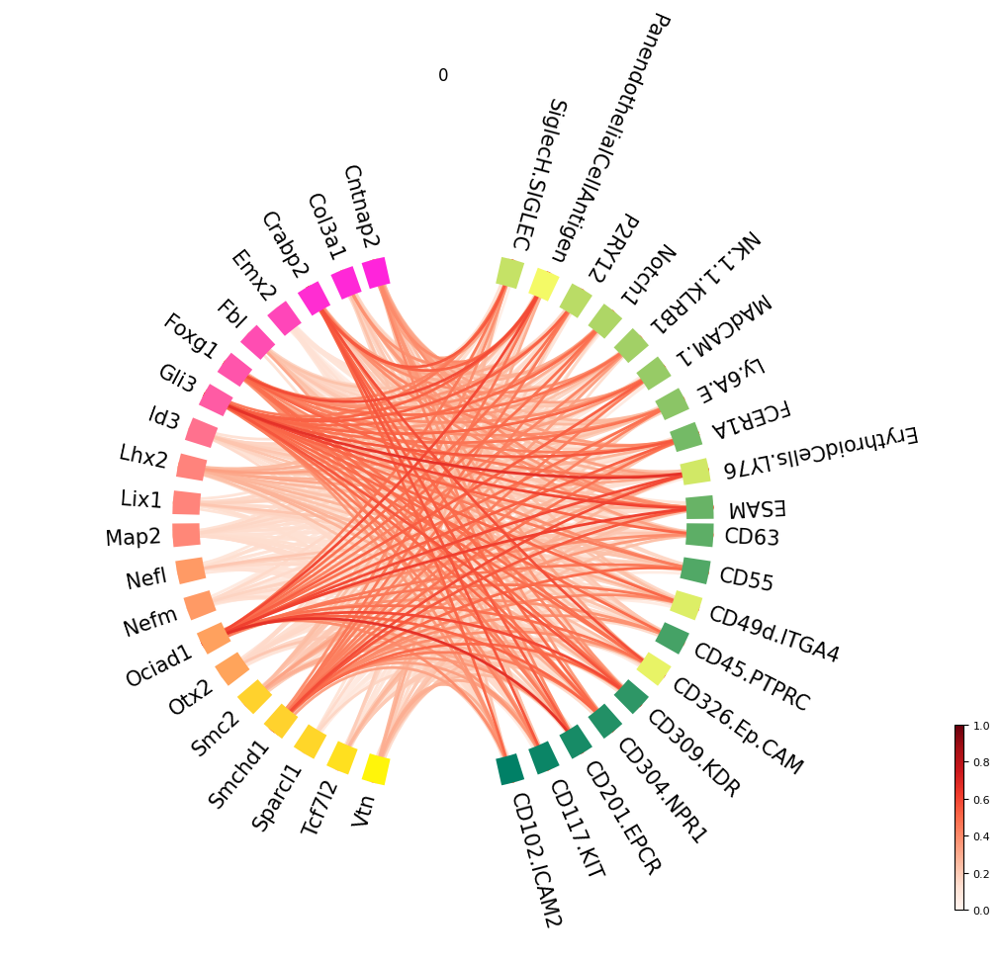

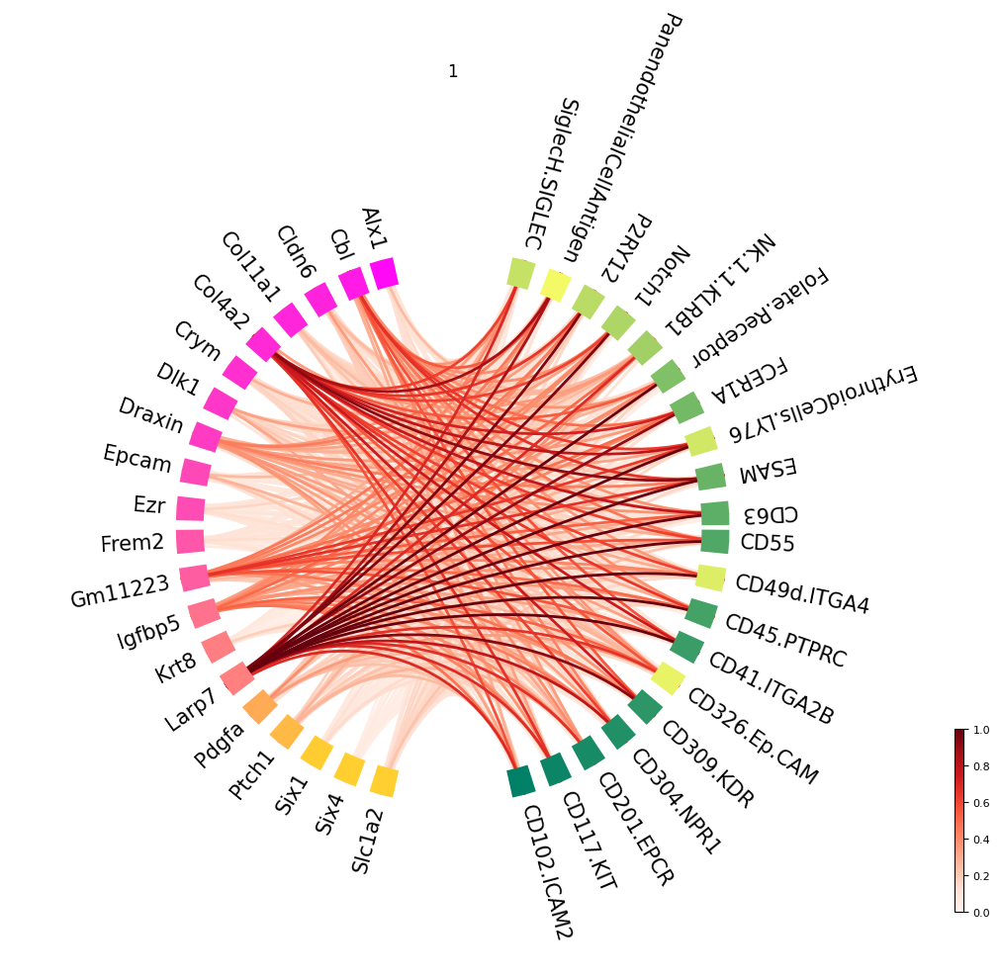

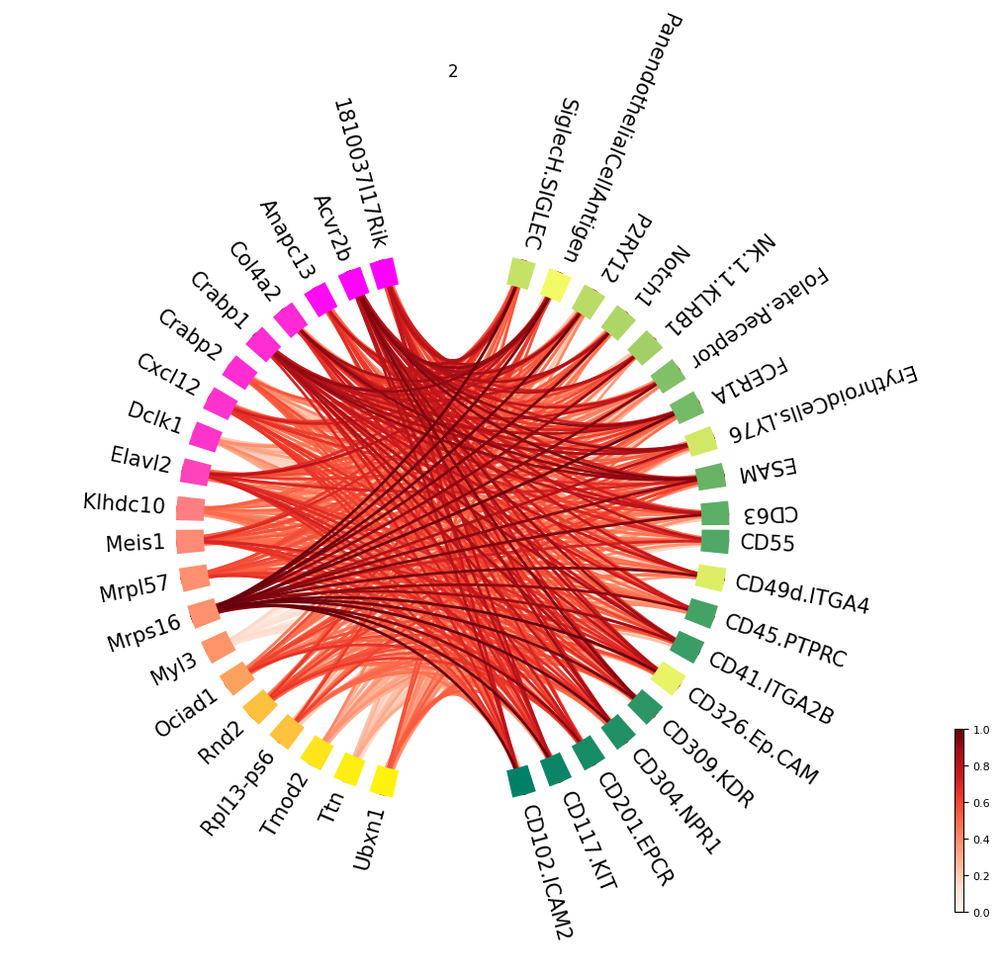

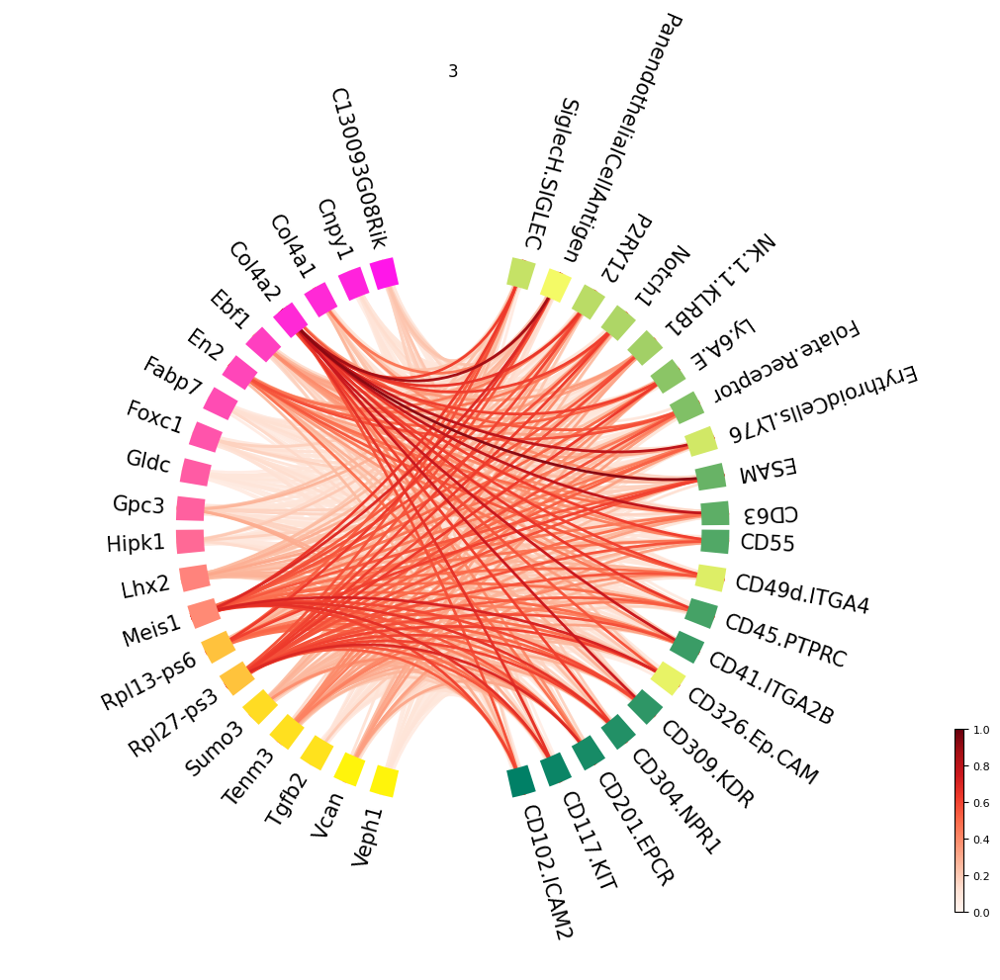

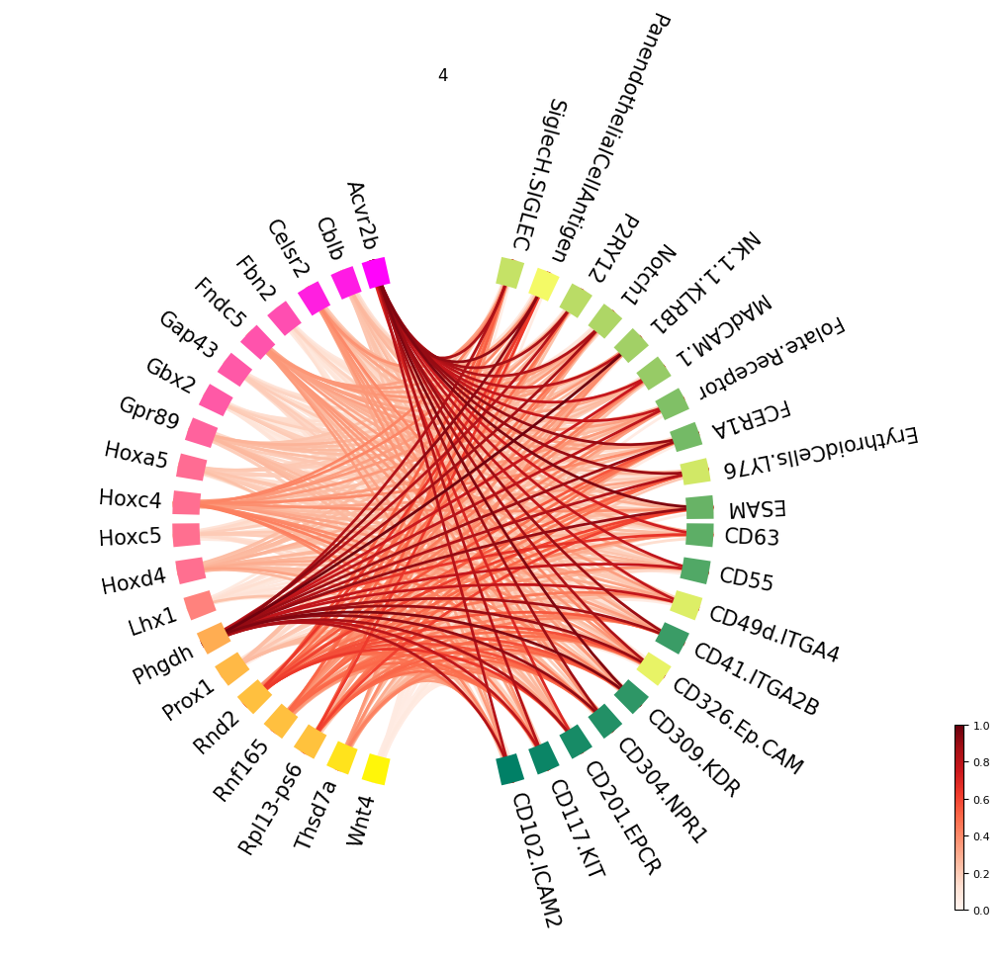

...

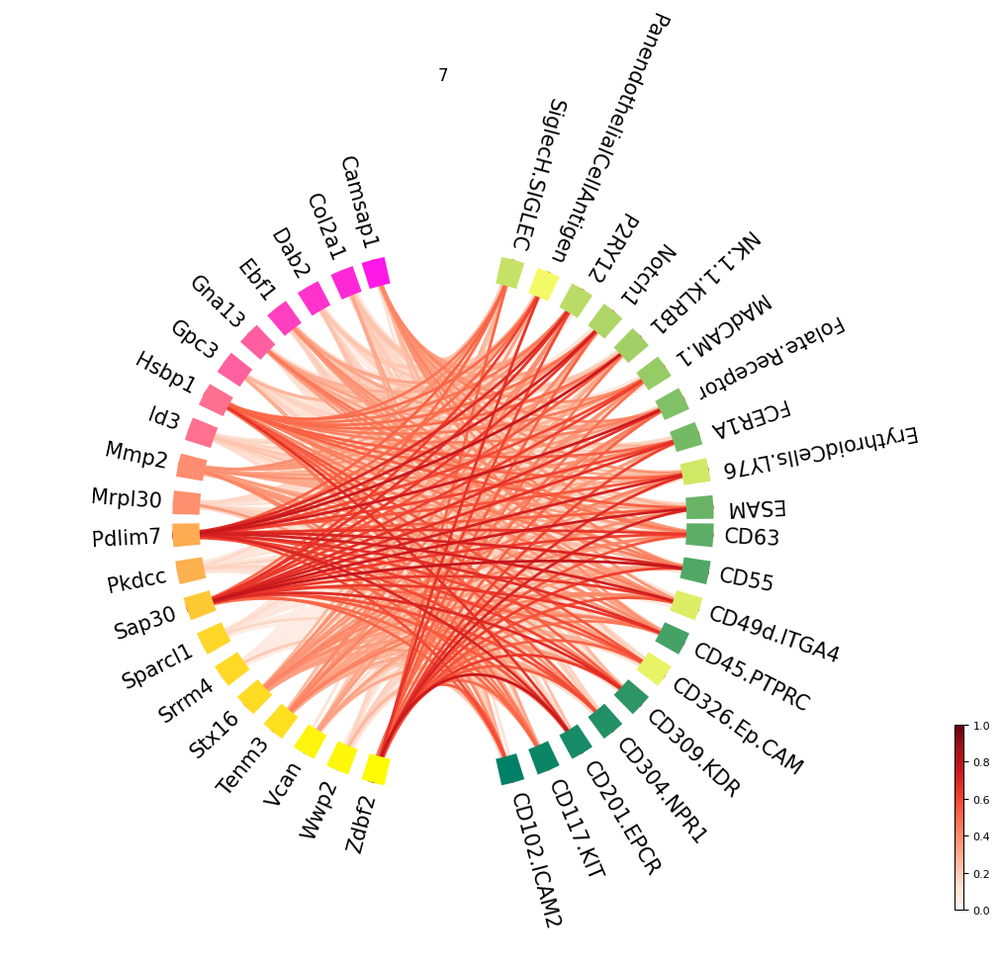

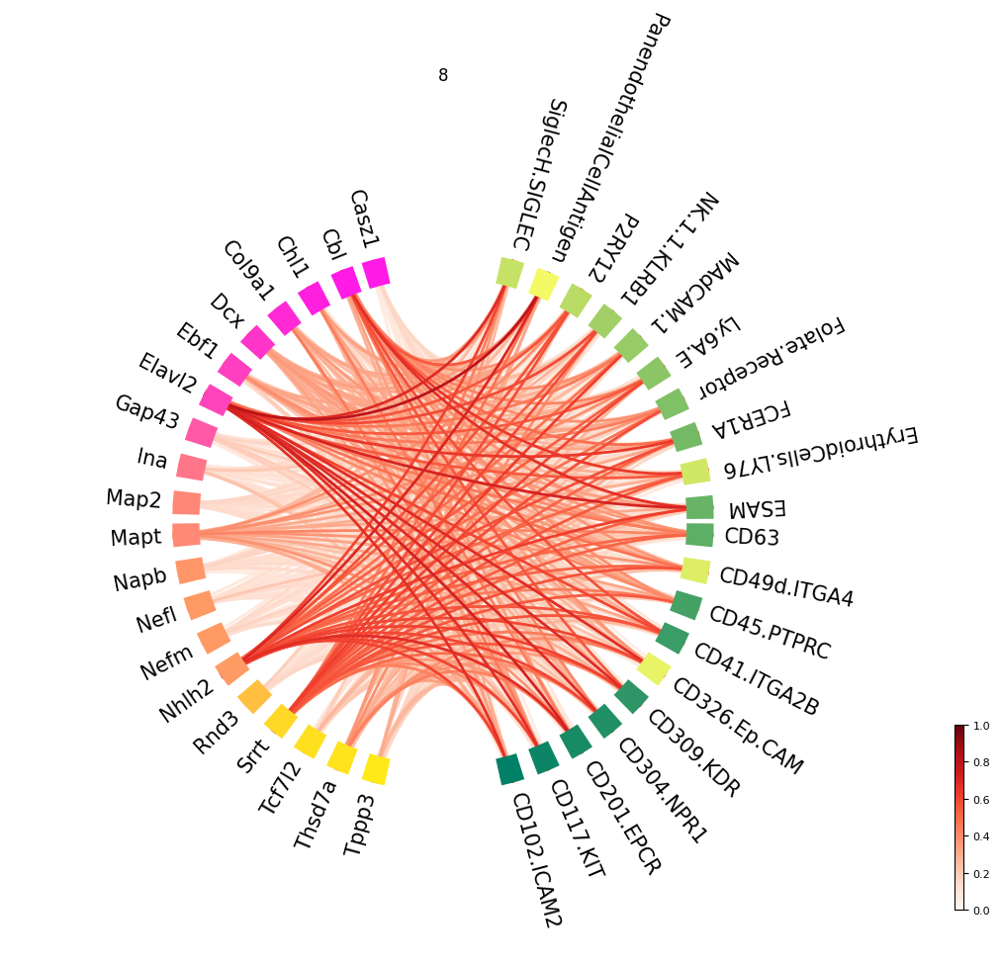

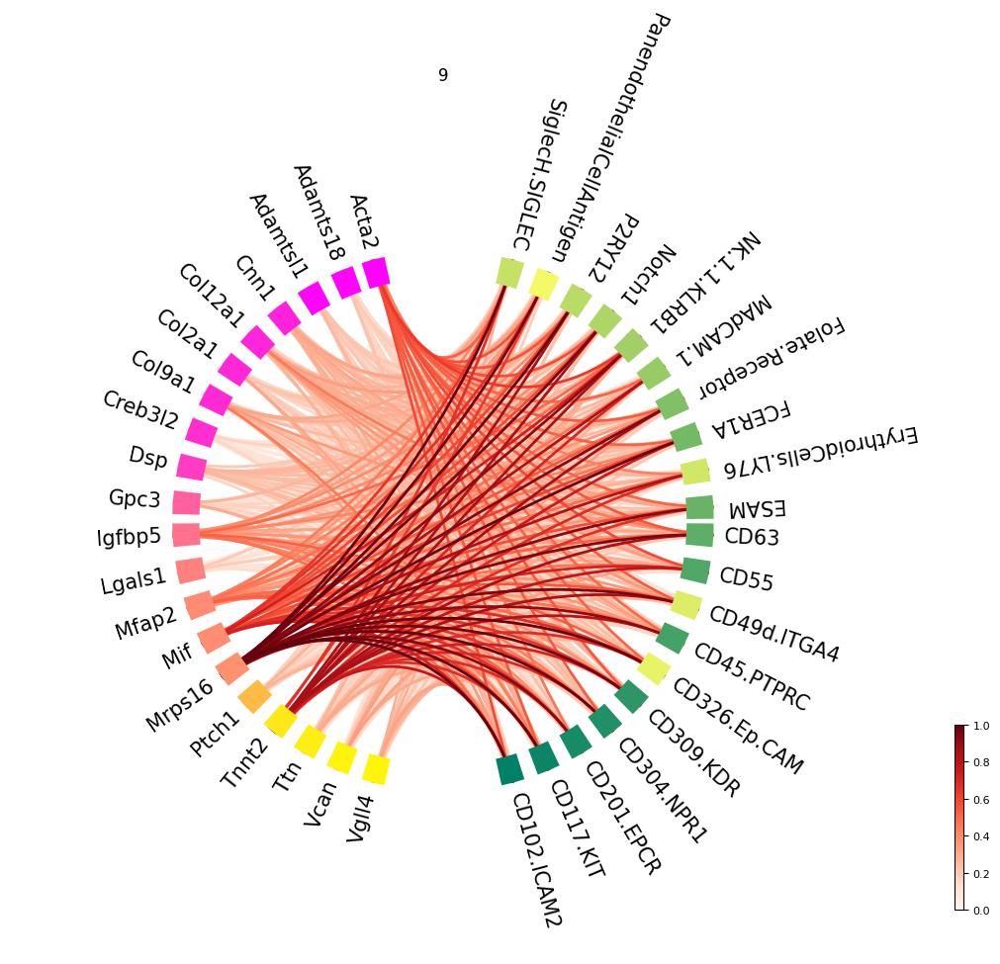

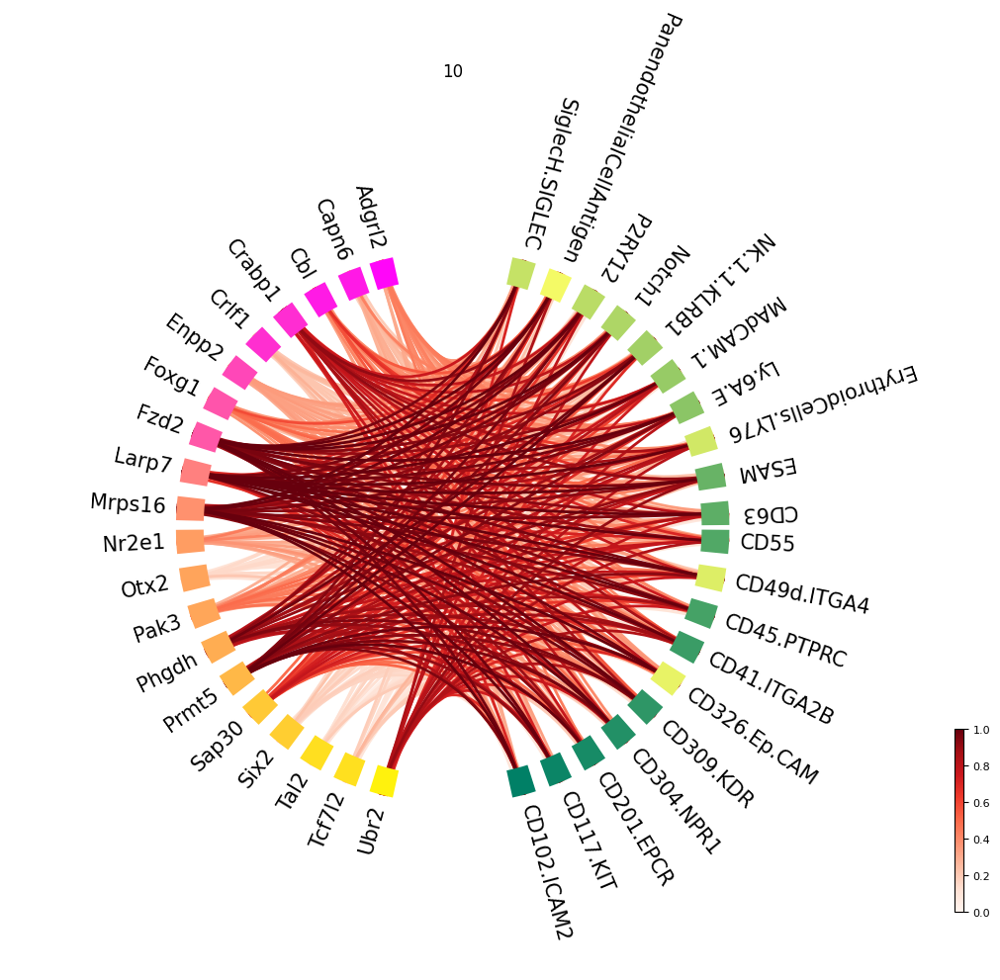

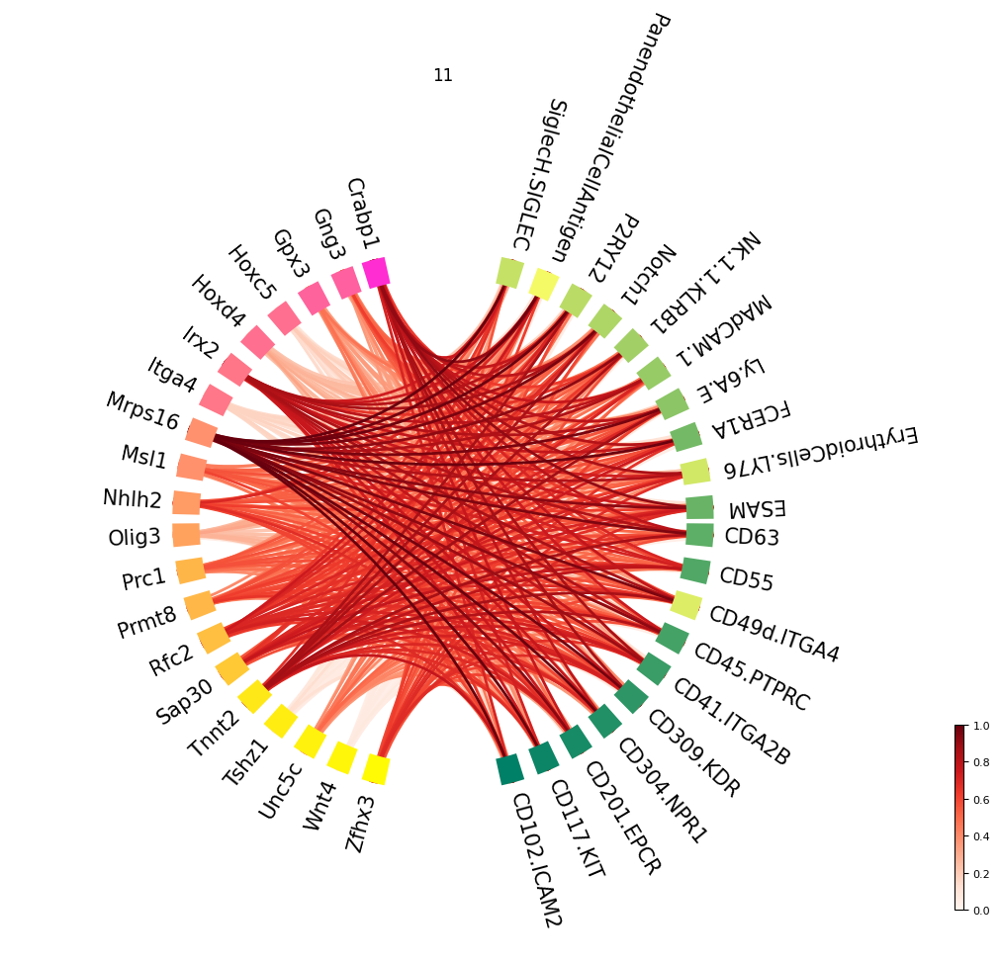

In [61]:
feature_feature_relevance(rna_index, protein_index, make_plot = True)

({0: array([[0.7724394 , 0.26484294, 0.29656143, 0.74117374, 0.37981442,
          0.4139043 , 0.51793433, 0.30778903, 0.5481715 , 0.48680921,
          0.58601447, 0.40900005, 0.81244576, 0.63550878, 0.4703463 ,
          0.546637  , 0.54368449, 0.4781409 , 0.72497752, 0.41746926],
         [0.43491883, 0.35597177, 0.21868302, 0.32618871, 0.32451214,
          0.3009103 , 0.15334077, 0.2583199 , 0.15820848, 0.70552963,
          0.23305889, 0.57578778, 0.43943756, 0.19210484, 0.3826694 ,
          0.4488241 , 0.14660253, 0.28934235, 0.32302958, 0.34107974],
         [0.48211474, 0.42089041, 0.70001781, 0.37891316, 0.50716305,
          0.38052903, 0.34966482, 0.22959382, 0.28607669, 0.51210473,
          0.53872917, 0.34175251, 0.4921475 , 0.18343124, 0.24051637,
          0.31643133, 0.23910112, 0.54040177, 0.3845931 , 0.38448756],
         [0.33513344, 0.10855931, 0.14486164, 0.47043262, 0.14130544,
          0.23480167, 0.17976327, 0.07560183, 0.24483174, 0.12431187,
          0.24

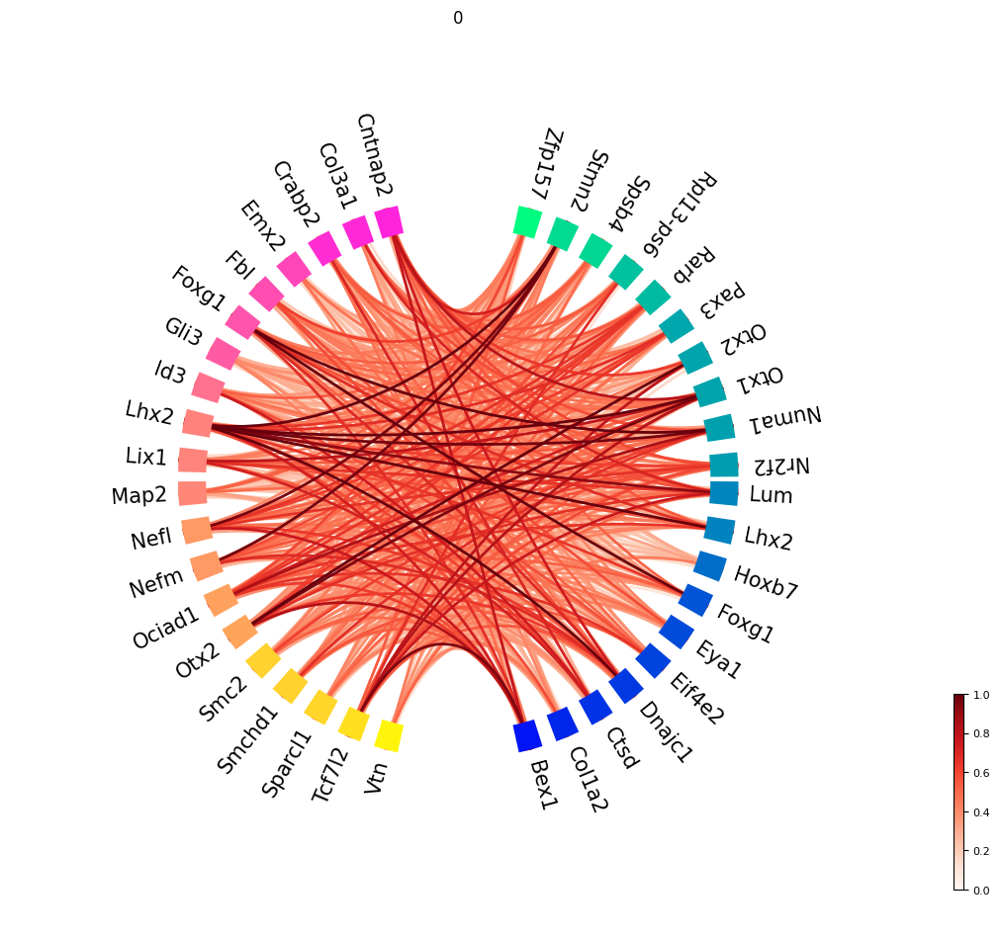

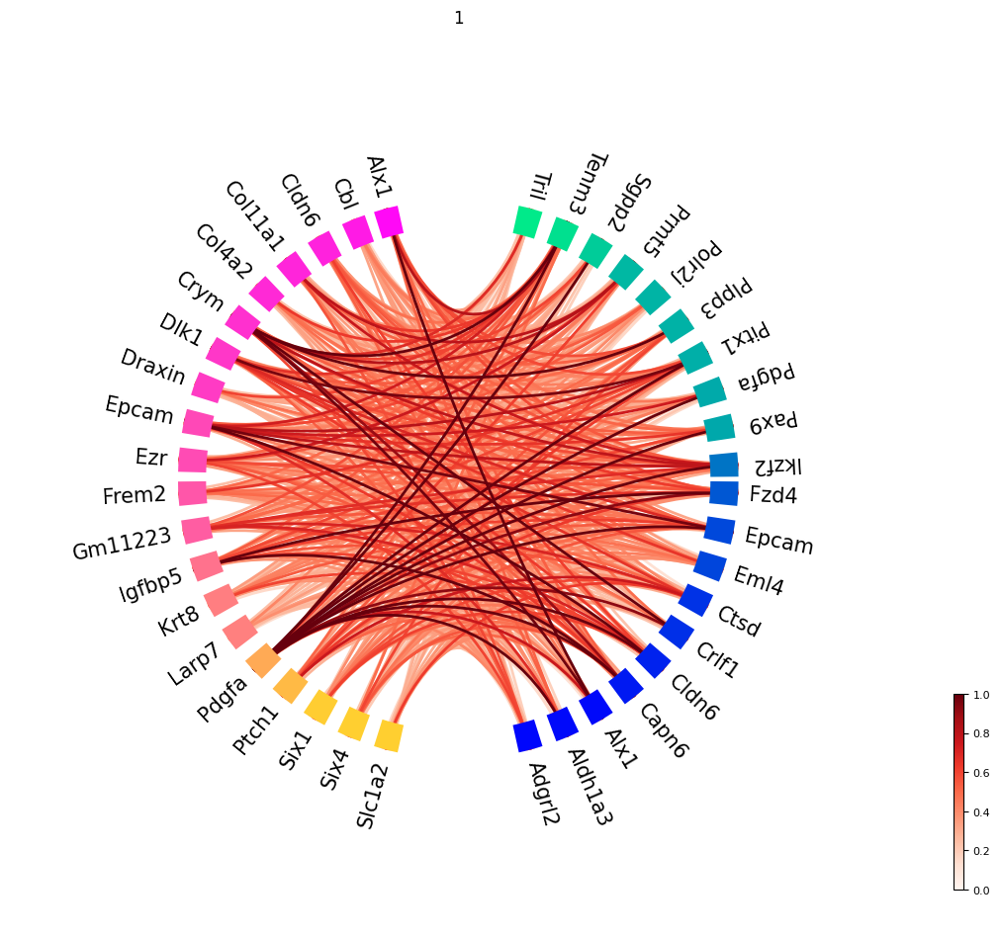

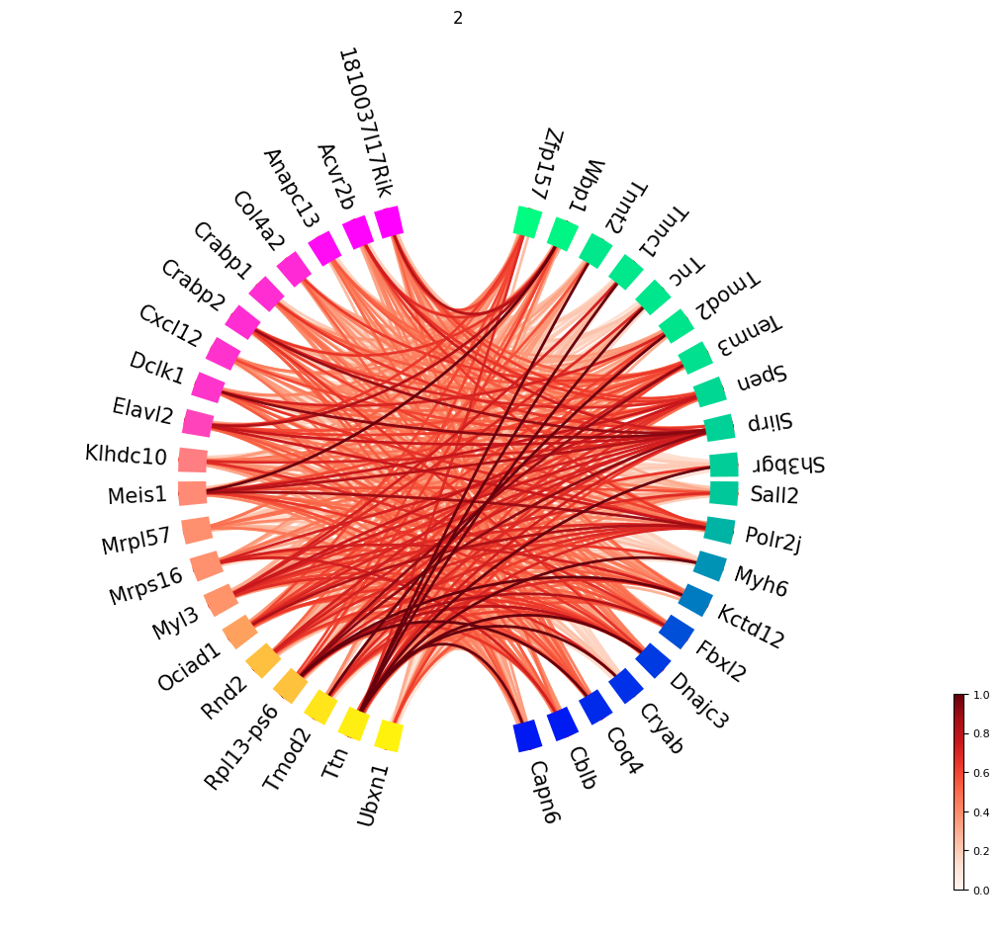

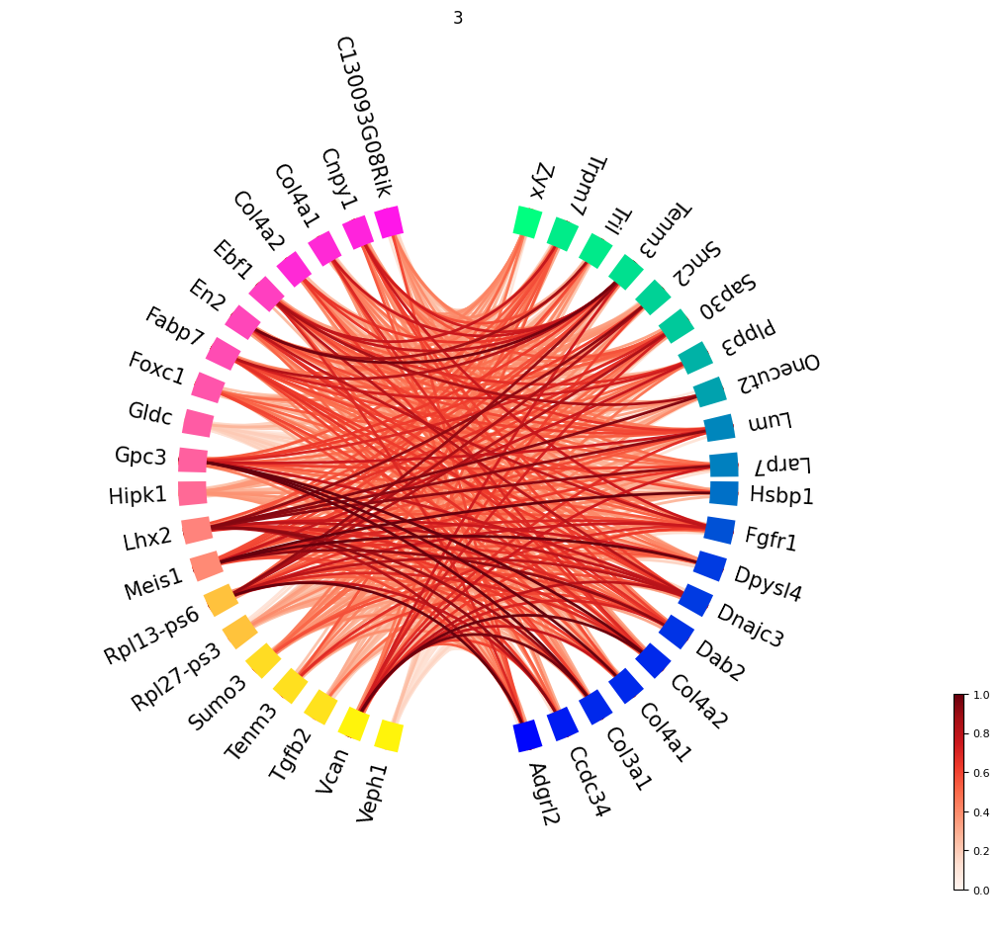

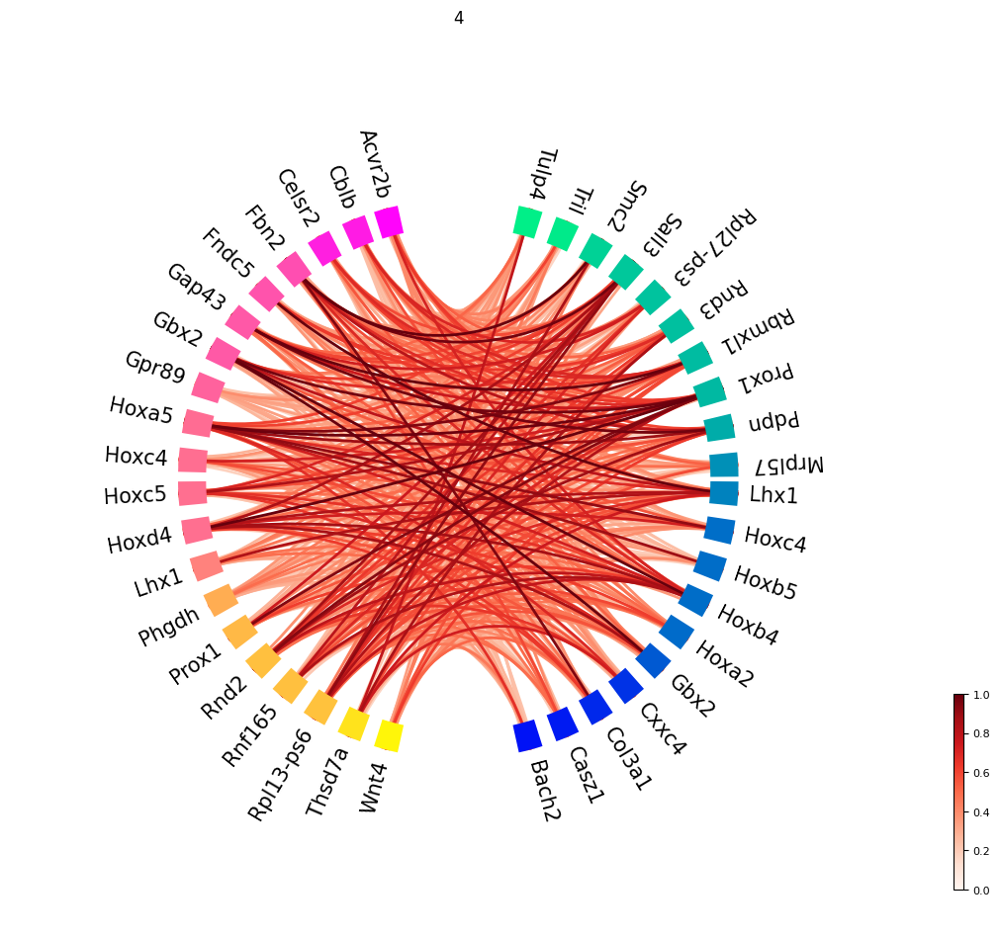

...

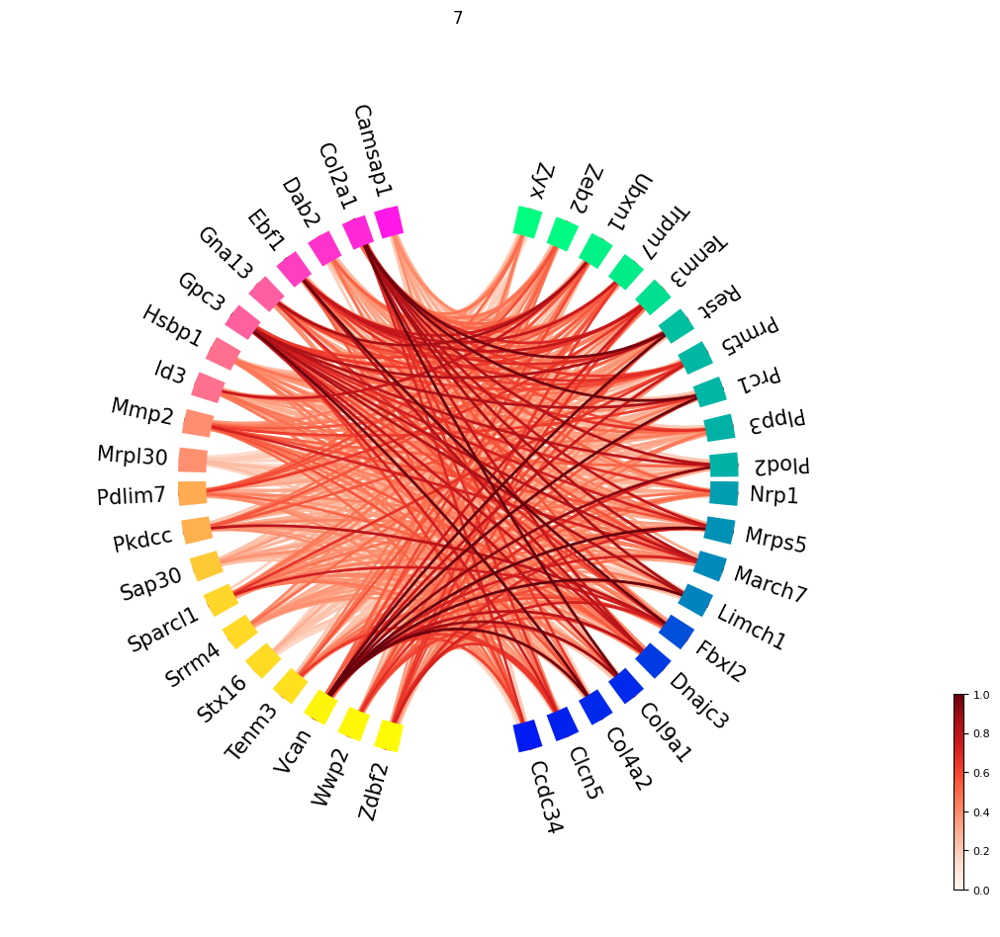

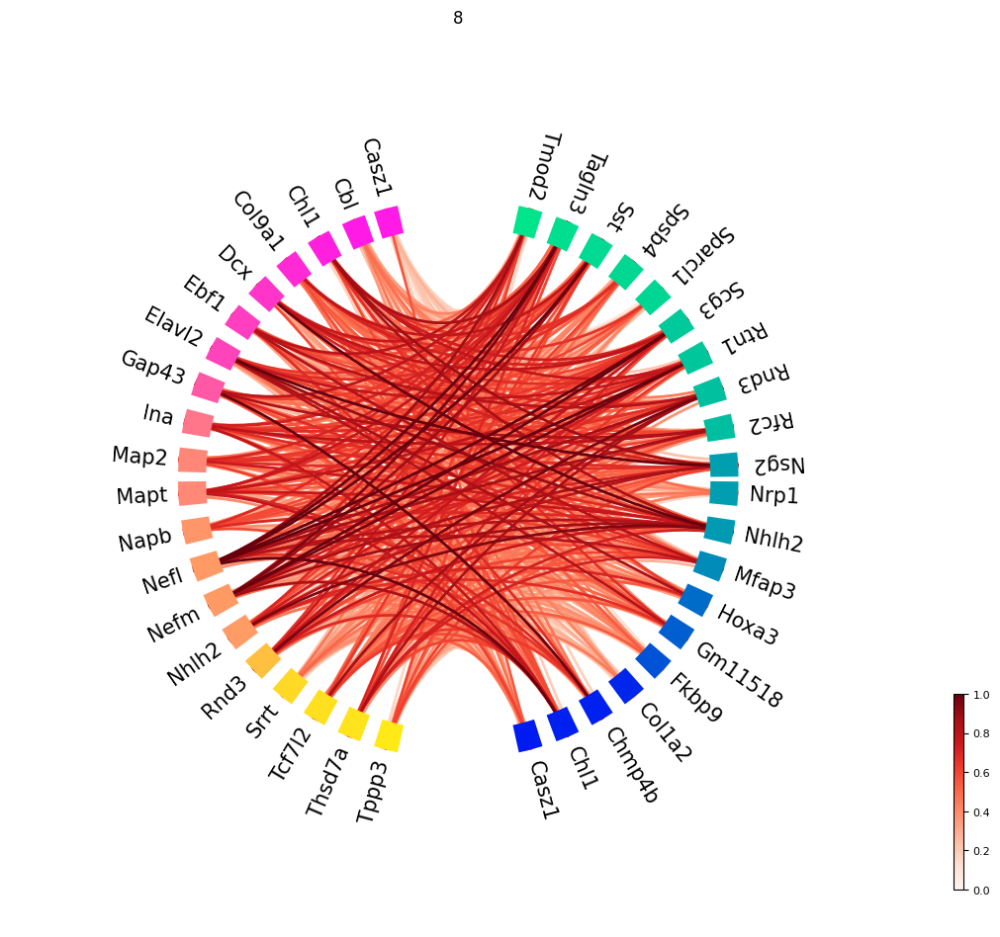

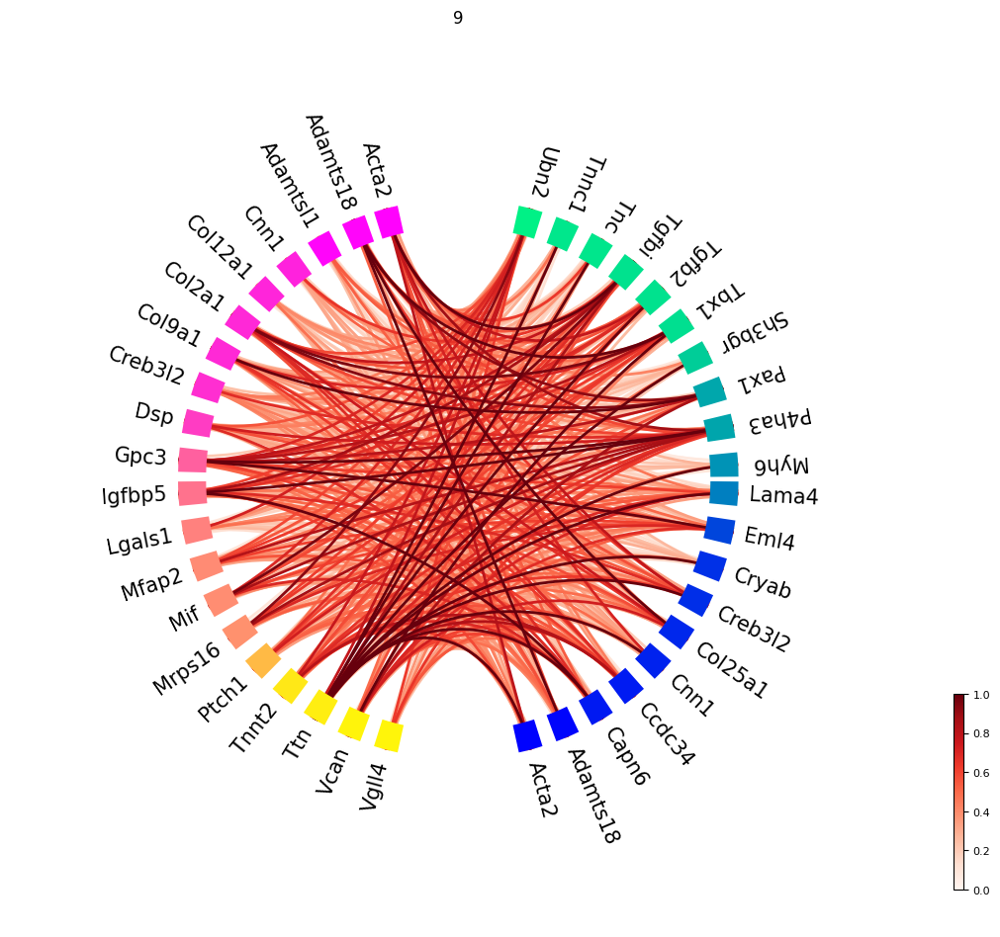

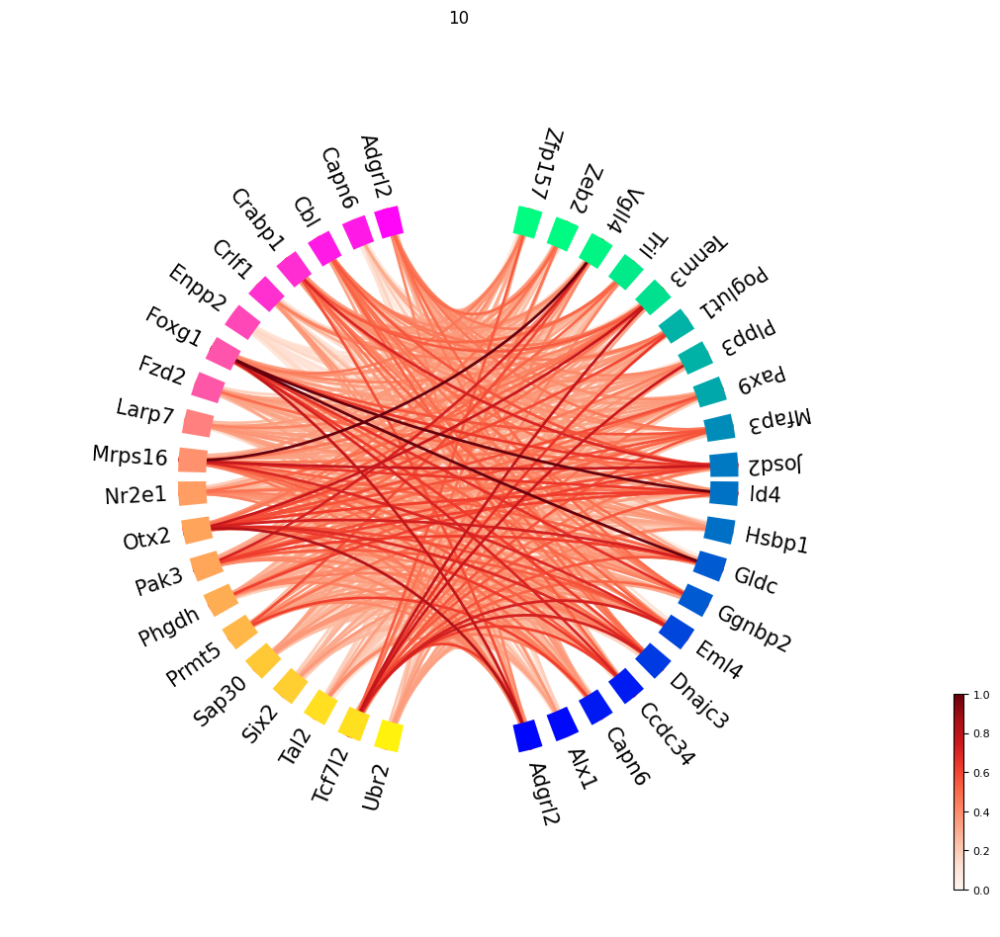

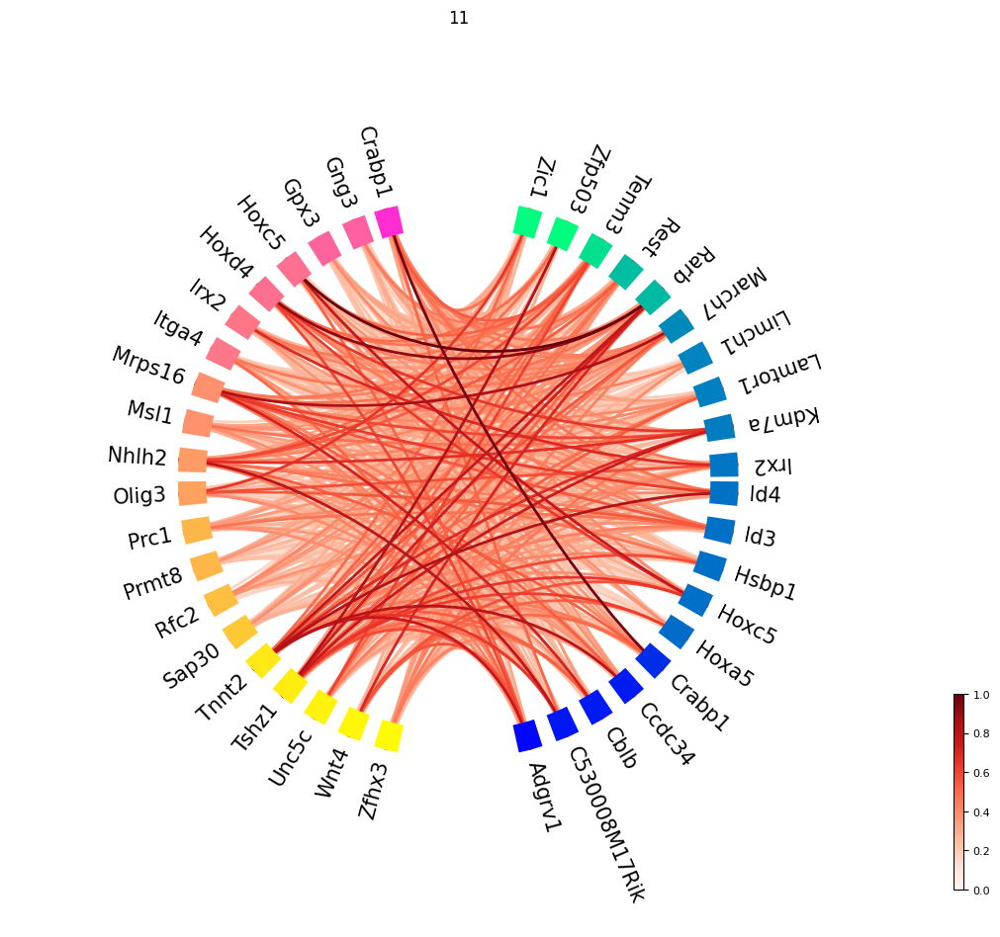

In [62]:
feature_feature_relevance(rna_index, niche_index, make_plot = True)

({0: array([[0.37781793, 0.35469812, 0.46602931, 0.39563165, 0.1001914 ,
          0.20264621, 0.4043399 , 0.27066894, 0.44706187, 0.11988815,
          0.33058997, 0.34294449, 0.5618983 , 0.64867088, 0.26477994,
          0.23674354, 0.48766644, 0.27748496, 0.2959681 , 0.23243276],
         [0.5985795 , 0.40836833, 0.4197472 , 1.        , 0.52877272,
          0.68897306, 1.        , 0.66519529, 1.        , 0.20339681,
          1.        , 0.64535076, 1.        , 0.95492555, 0.41154743,
          0.49948534, 0.66395787, 1.        , 1.        , 0.70748387],
         [0.11162269, 0.11192609, 0.14120504, 0.13750138, 0.06465237,
          0.1018243 , 0.21036025, 0.06700447, 0.20047371, 0.06768059,
          0.11528223, 0.1877217 , 0.14166637, 0.06528794, 0.07951629,
          0.04901586, 0.07290643, 0.06490253, 0.1070978 , 0.15031211],
         [0.43787161, 0.45327555, 0.22252023, 0.10676508, 0.46575475,
          0.28463805, 0.16966996, 0.15014471, 0.20445468, 0.35157294,
          0.10

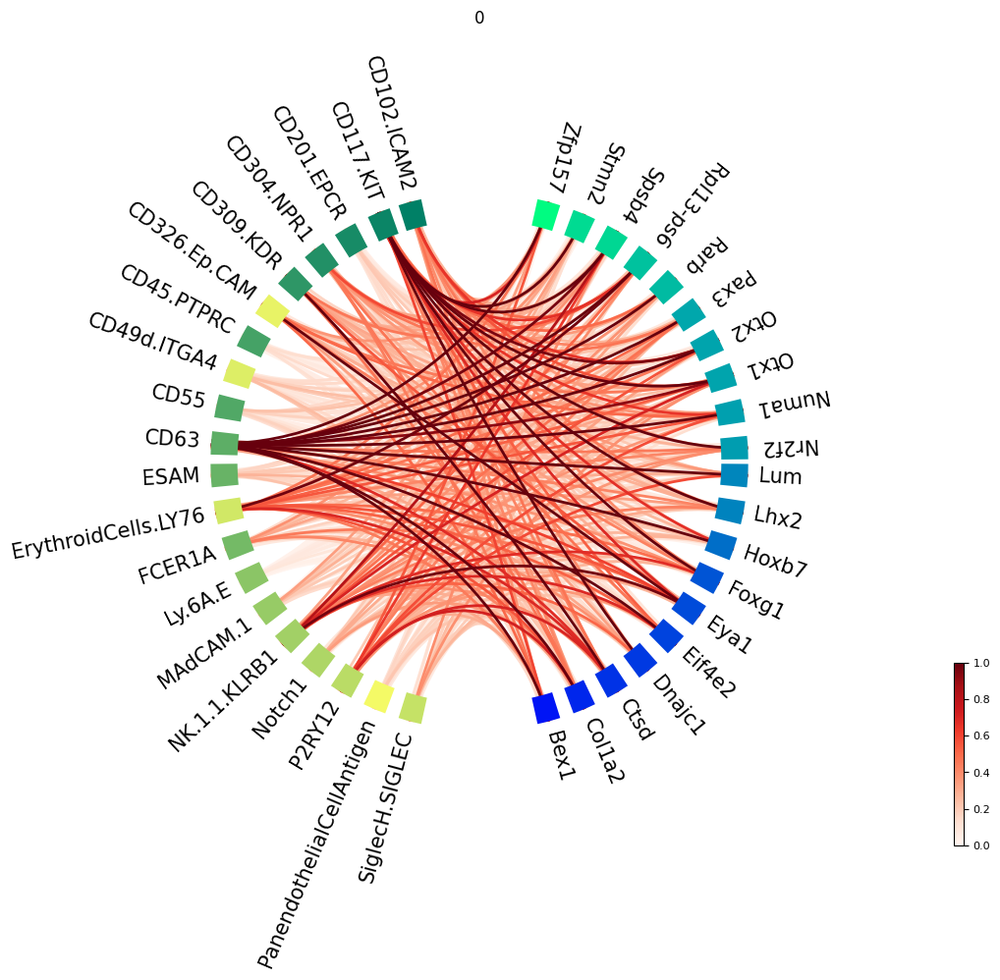

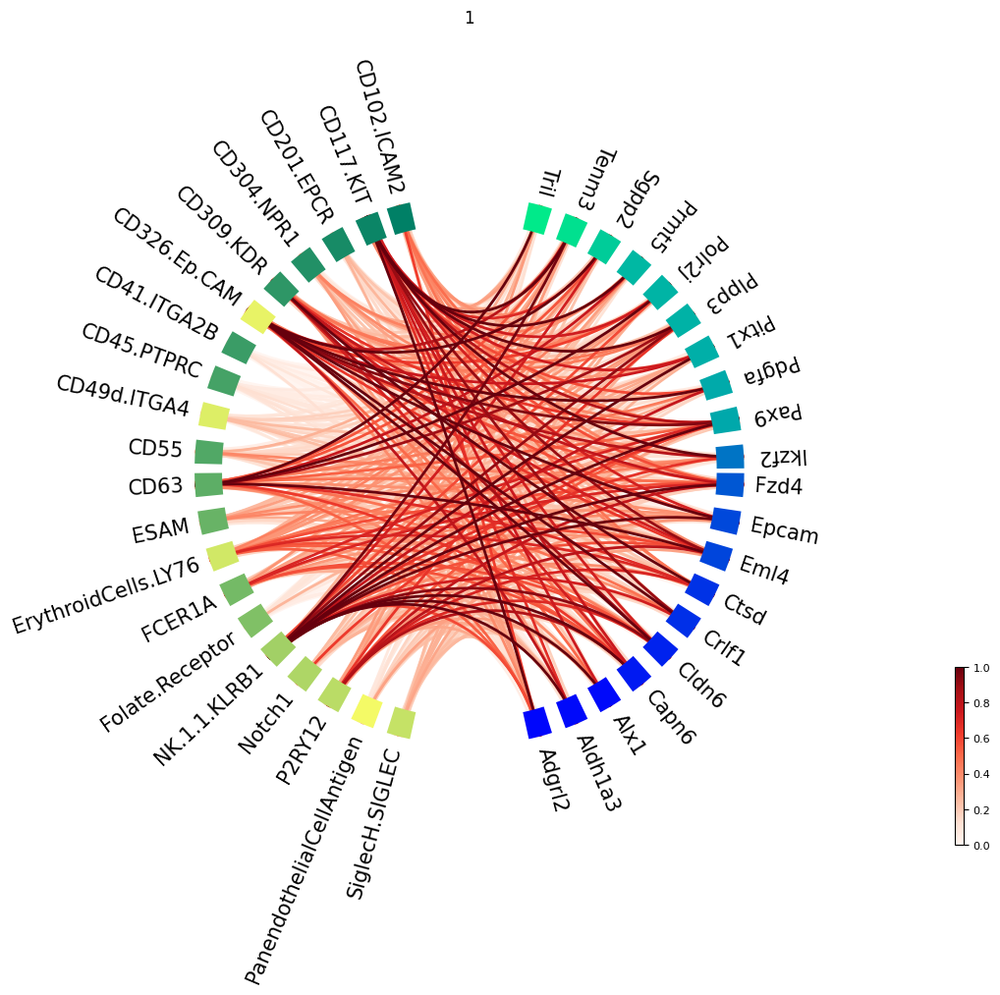

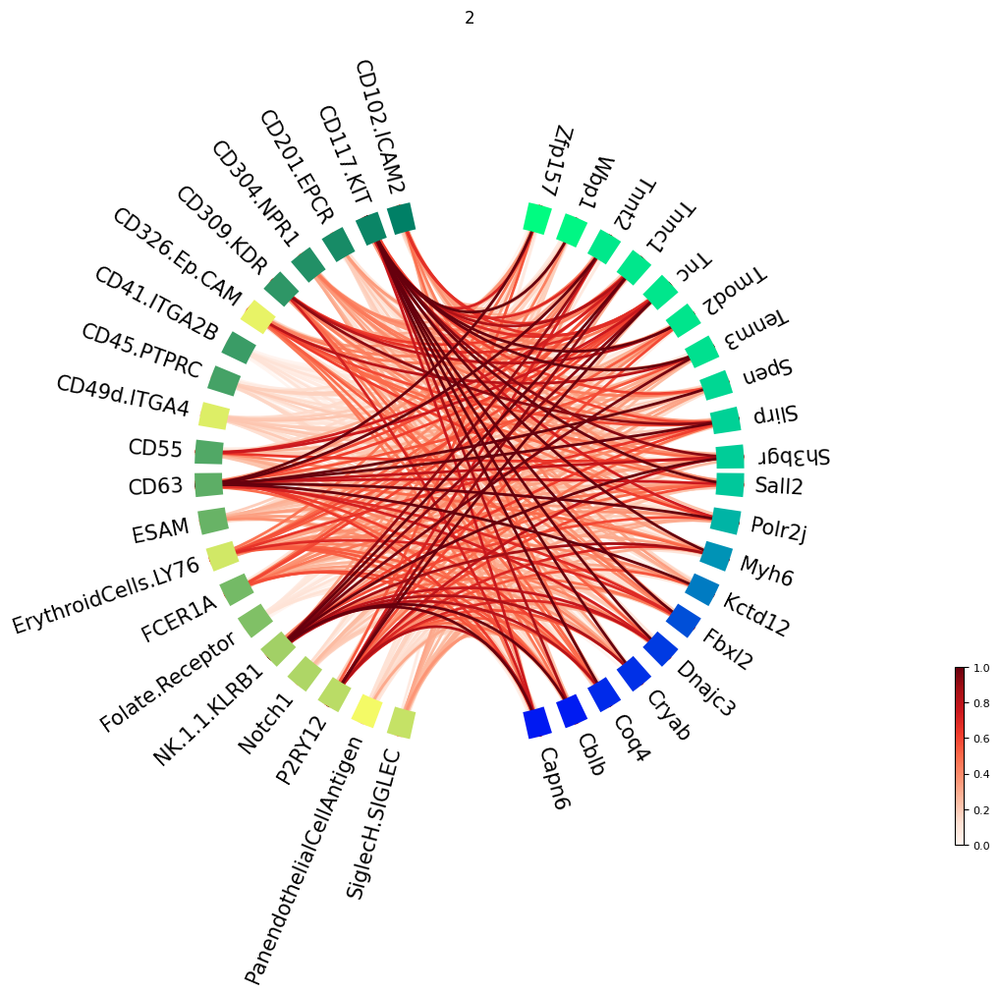

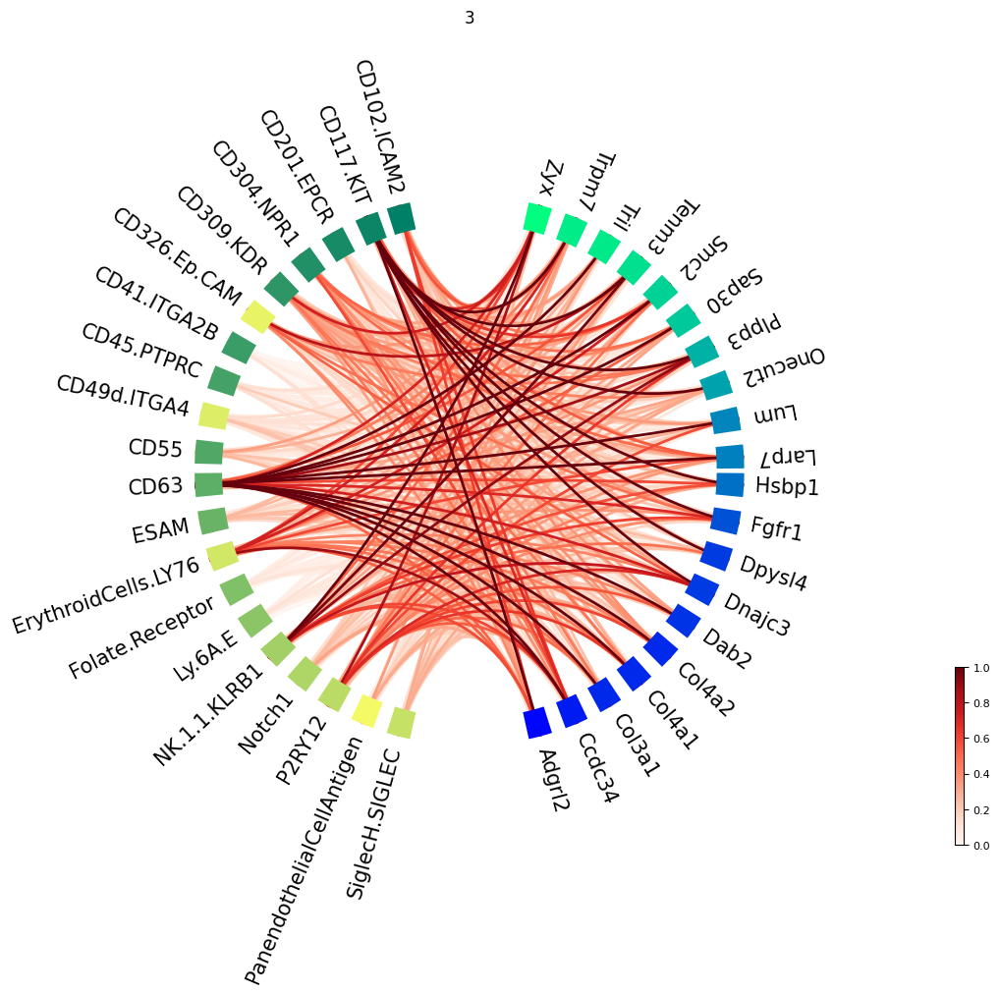

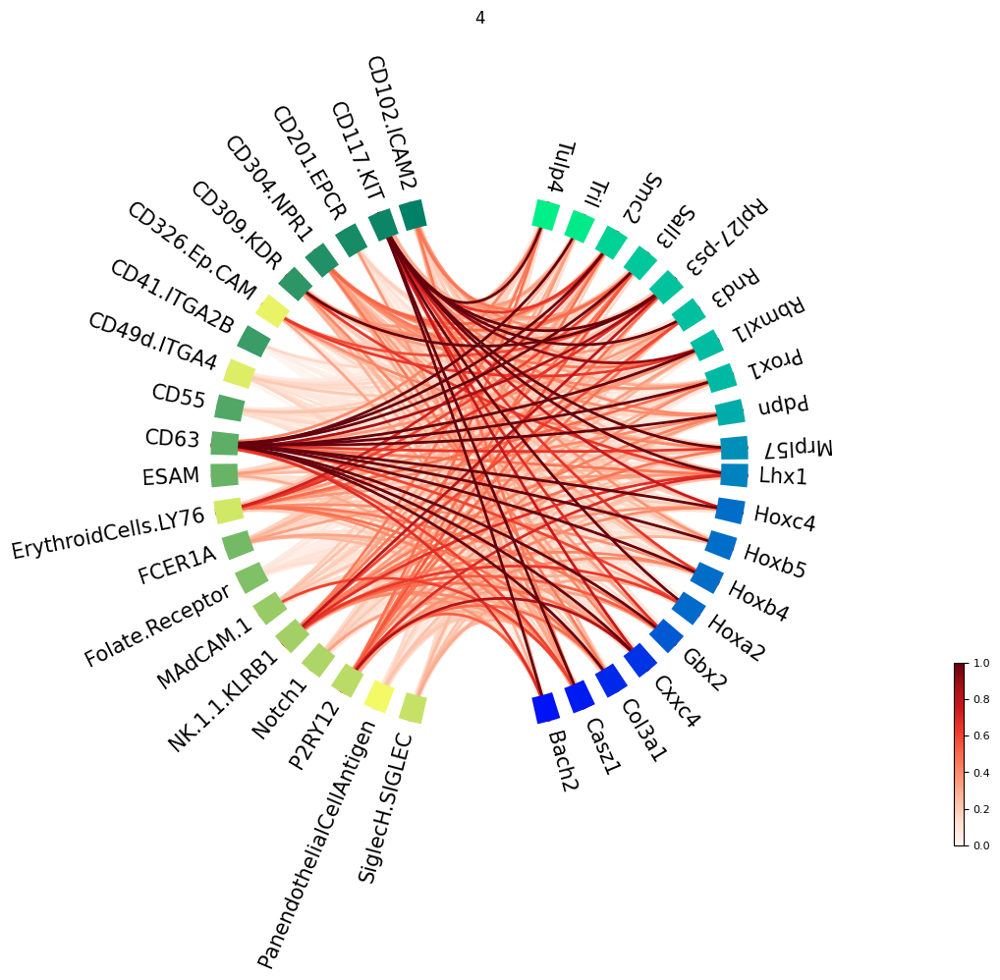

...

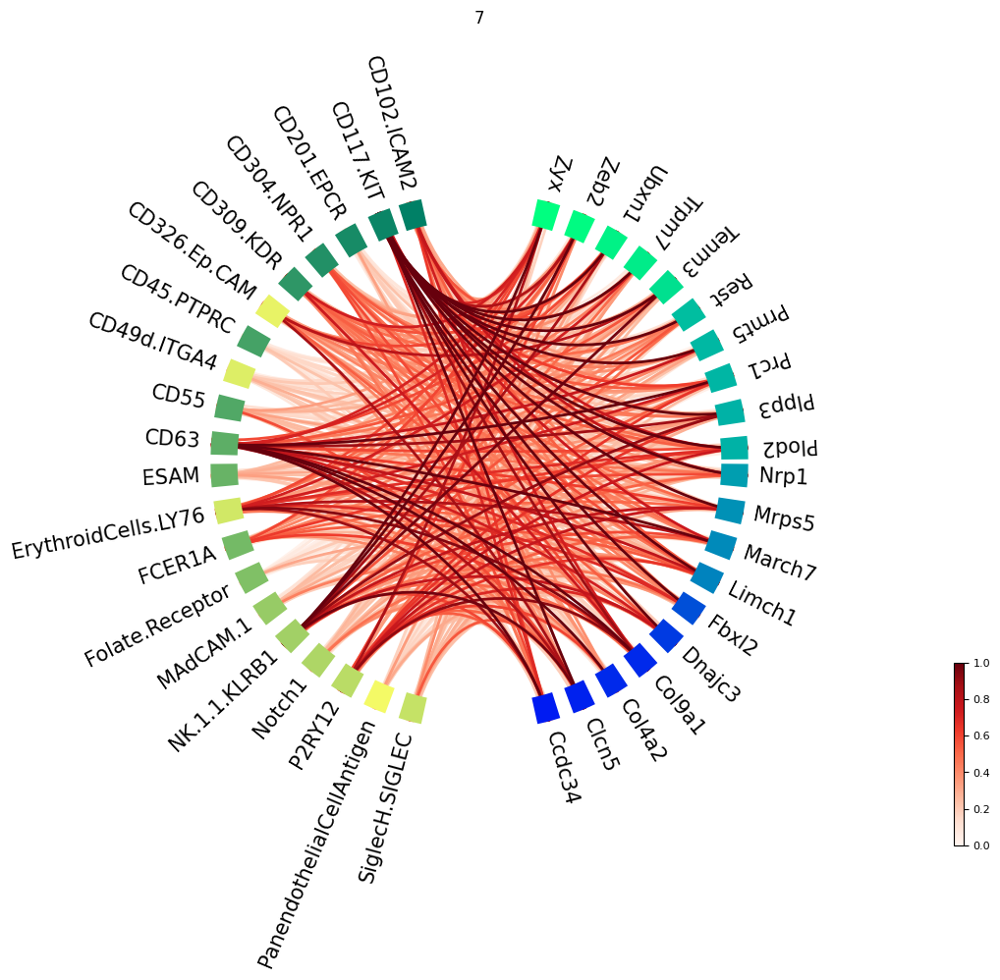

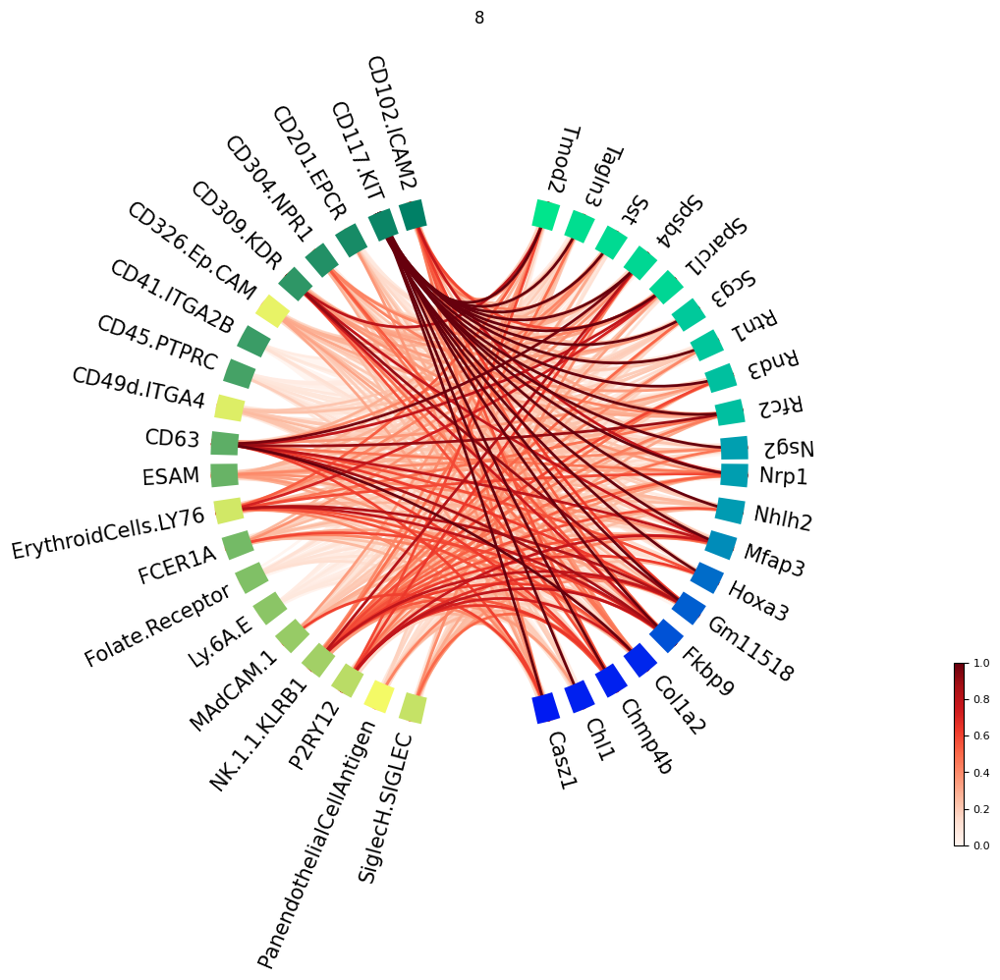

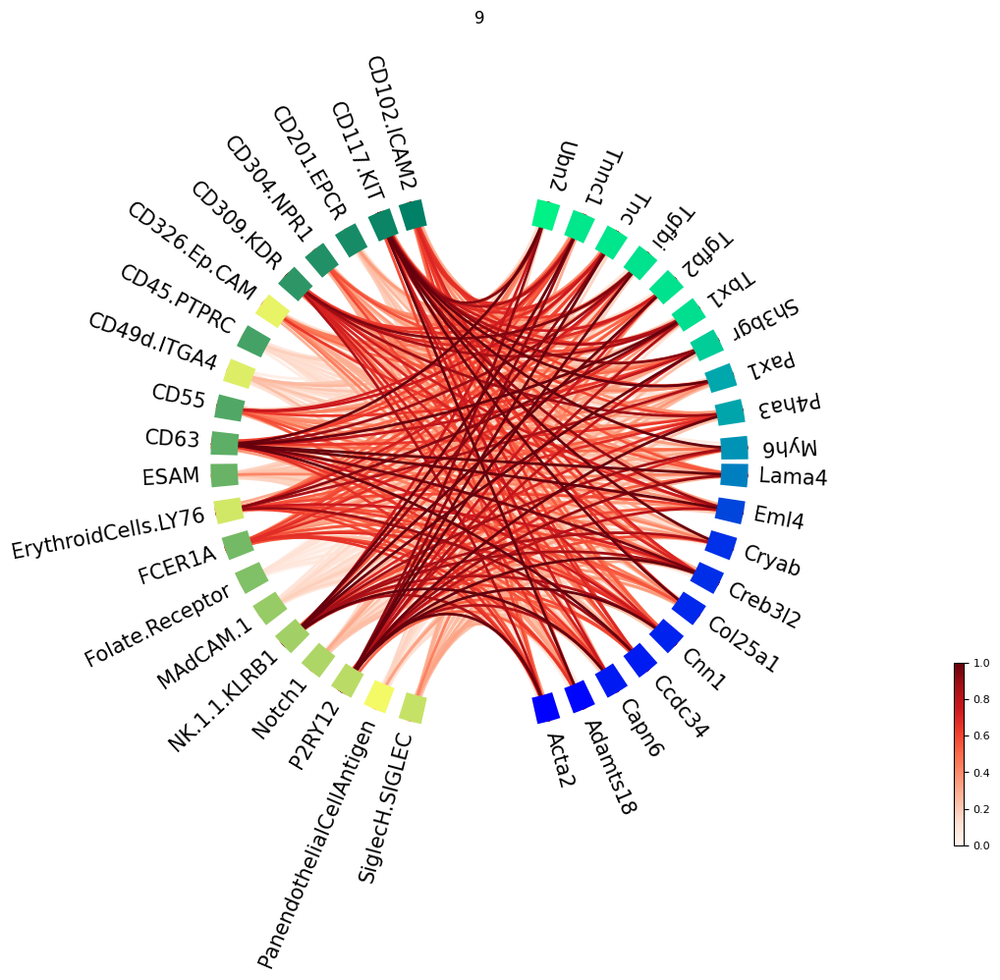

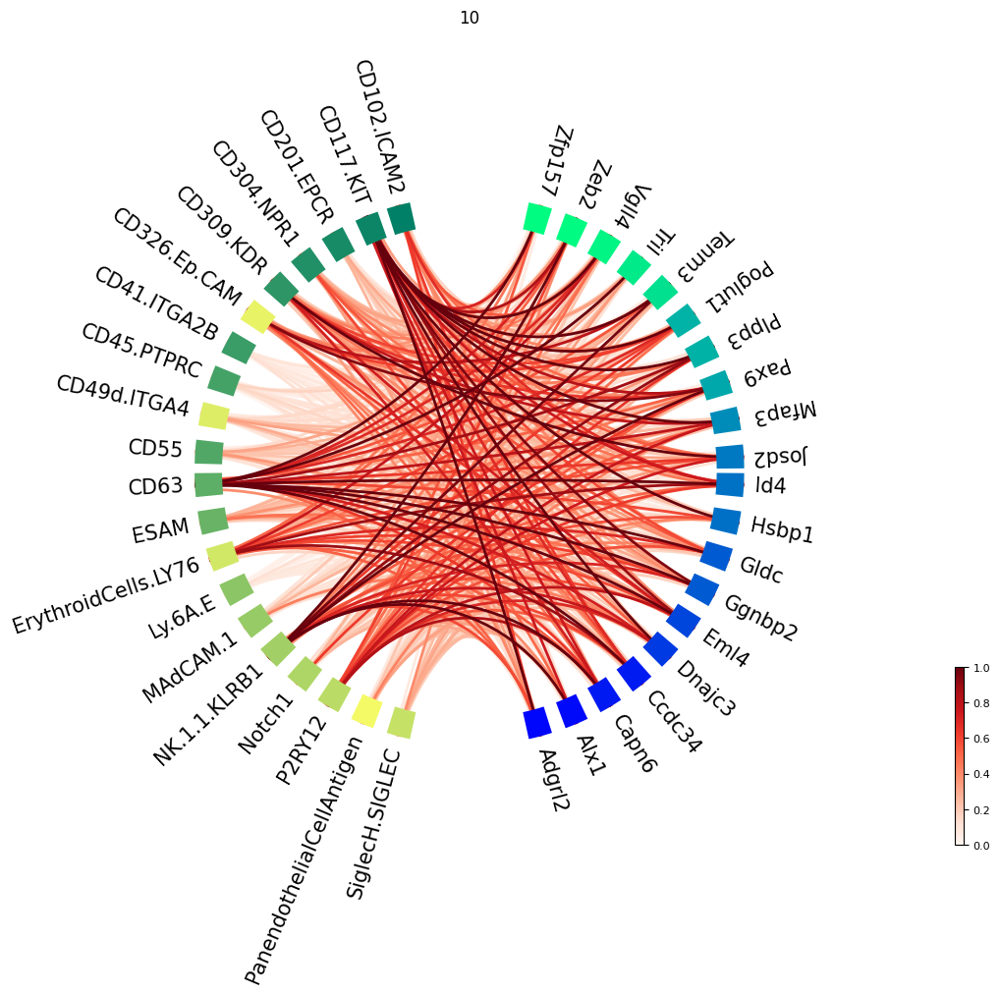

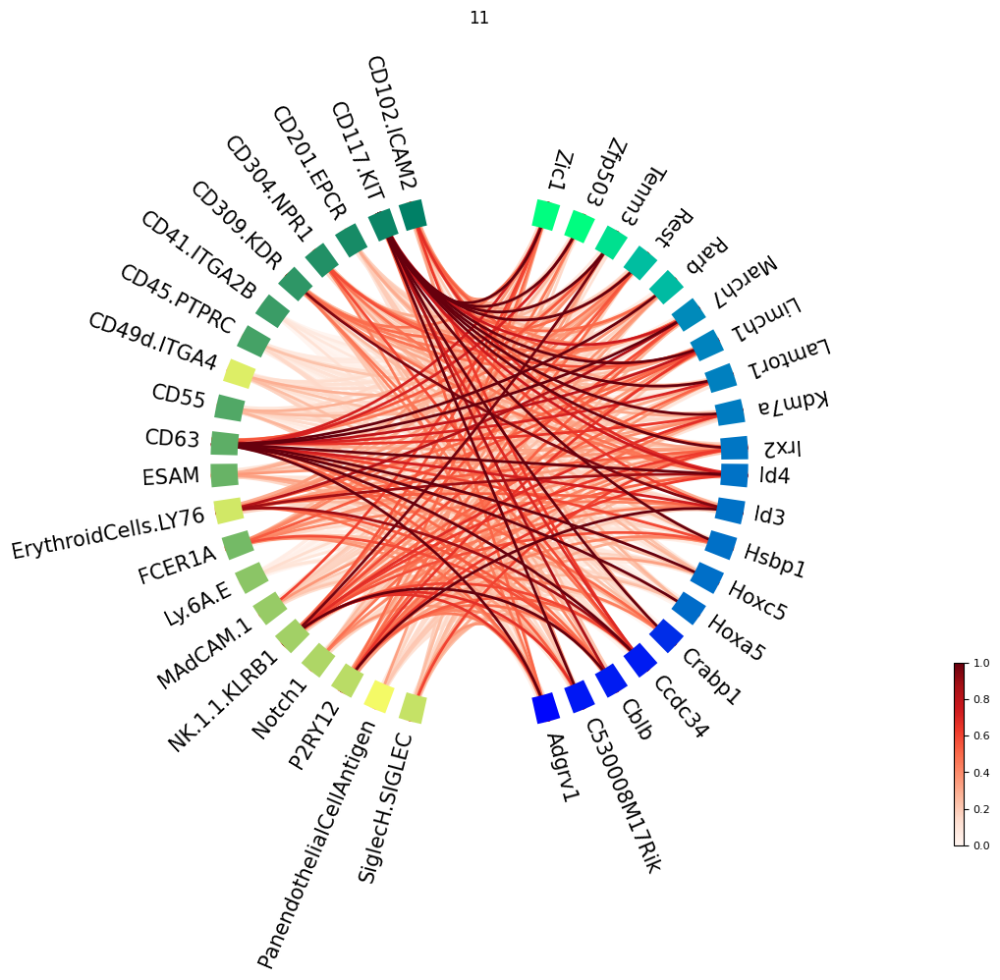

In [63]:
feature_feature_relevance(protein_index, niche_index, make_plot = True)

In [65]:
source_index = rna_index
target_index = protein_index
id2modality = {0: "RNA", 1: "Protein", 2: "Niche"}
rows = []

combinations = [[rna_index, protein_index], [rna_index, niche_index], [protein_index, niche_index]]

def feature_feature_values(source_index, target_index):
    values, labels = feature_feature_relevance(source_index, target_index, make_plot=False)

    for cluster_id, connections in values.items():
        cluster_labels = labels[cluster_id]
        source_labels = cluster_labels[0]
        target_labels = cluster_labels[1]
        target2source = np.transpose(connections)
        for target_label_id, target_label in enumerate(target_labels):
            for source_label_id, source_label in enumerate(source_labels):
                rows.append(
                    {
                        "Cluster": cluster_id,
                        "Direction": f"{id2modality[source_index]} -> {id2modality[target_index]}",
                        "Target": target_label,
                        "Source": source_label,
                        "Value": target2source[target_label_id][source_label_id],
                    }
                )

for comb in combinations:
    feature_feature_values(comb[0], comb[1])

df = pd.DataFrame(rows)
print(df)
feature_feature_file_path = f'{saved_results}/feature_feature_importance.csv'
if not Path(feature_feature_file_path).exists():
    df.to_csv(feature_feature_file_path, index=False)

       Cluster         Direction       Target                     Source  \
0            0    RNA -> Protein  CD102.ICAM2                    Cntnap2   
1            0    RNA -> Protein  CD102.ICAM2                     Col3a1   
2            0    RNA -> Protein  CD102.ICAM2                     Crabp2   
3            0    RNA -> Protein  CD102.ICAM2                       Emx2   
4            0    RNA -> Protein  CD102.ICAM2                        Fbl   
...        ...               ...          ...                        ...   
13195       11  Protein -> Niche         Zic1               NK.1.1.KLRB1   
13196       11  Protein -> Niche         Zic1                     Notch1   
13197       11  Protein -> Niche         Zic1                     P2RY12   
13198       11  Protein -> Niche         Zic1  PanendothelialCellAntigen   
13199       11  Protein -> Niche         Zic1             SiglecH.SIGLEC   

          Value  
0      0.207462  
1      0.154874  
2      0.505608  
3      0.062110